# Foreclosure Franchise Spatial Analysis Notebook

This notebook was created to support reporting for a Miami Herald series named The Foreclosure Franchise by Ben Wieder, Shirsho Dasgupta, and Sheridan Wall. The investigation looked at how cities across Florida partnered with an outside attorney to ramp up foreclosures — hoping to raise cash, but hurting vulnerable property owners in the process. The [first story](https://www.miamiherald.com/news/business/real-estate-news/article273093600.html) looked at how the increase in foreclosures has taken away properties that have been in families for generations, particularly in heavily Black areas.

Wieder, Dasgupta, and Wall spent months combing through court records for 779 lien-related foreclosure cases Matt Weidner has filed on behalf of city and county governments across Florida.

The reporters then manually reviewed the court documents from each lawsuit and built a database recording relevant details about each case including location. Separately, the Herald also filed more than two-dozen records requests with governments that Weidner has represented and governments in South Florida.

One of the cities that Weidner filed the most lawsuits in was St. Petersburg, FL and reporters had through interviews heard that these foreclosures seemed to be hitting black communities particularly in the city.

This notebook was used to map where Weidner filed lawsuits in St. Pete using a [subset of the Herald's dataset](https://docs.google.com/spreadsheets/d/1R_yfTDpfWifuKkF2Ww7QORUNHr70_bF9MQHGTrEQWVA/edit?usp=sharing) and look at how these areas related to other factors such as race, income, age of building, etc.



**Source**

Data:

*   2021 American Community Survey (accessed through Census API)
*   2020 County Census Data from TIGER FTP
*   St.Pete Liens Data




Overview:

1. Preparing the geojson files for mapping
2. Assigning points to census tracts
3. Looking at correlations between possible factors and where these foreclosures are located

### Imports

#### Google Drive Setup

In [ ]:
# # Load the Drive helper and mount
# from google.colab import drive

# # This will prompt for authorization.
# drive.mount('/content/drive')

In [ ]:
# # After executing the cell above, Drive
# # files will be present in "/content/drive/My Drive".
# !ls "/content/drive/My Drive/data_storage/2023_miami_foreclosure_franchise/"

-----

#### Importing libraries

In [ ]:
!pip install jsonschema==3.2
!pip install geopandas
!pip install jenkspy
!pip install cenpy
import random
import altair as alt
import numpy as np
import pandas as pd
import geopandas as gpd
import jenkspy
import cenpy as cen
import cenpy.tiger as tiger
from shapely.geometry import Point, Polygon
from getpass import getpass

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
# !pip install cenpy

In [ ]:
# !pip install --upgrade cenpy

In [ ]:
# Let's reset our pandas display
pd.reset_option('display.max_colwidth')

### Census/ACS Data

#### Importing Census Data for Florida using Cenpy and the U.S. Census API

In [ ]:
CENSUS_API_KEY = getpass('Enter your Census API Key: ')

Enter your Census API Key: ··········


What tables are available?

In [ ]:
availableTables = cen.explorer.available()
print(f"The API offers access to {len(availableTables)} datasets")

The API offers access to 1332 datasets


What tables are available for 2020?

In [ ]:
availableTables.loc[availableTables['vintage'] == 2020.0].head(2)

,c_isTimeseries,c_isMicrodata,publisher,temporal,spatial,programCode,modified,keyword,contactPoint,distribution,description,bureauCode,accessLevel,title,c_isAvailable,c_isCube,c_isAggregate,c_dataset,vintage
ABSCB2020,NaN,NaN,U.S. Census Bureau,2020/2020,US,006:007,2022-08-03 00:00:00.0,"(census,)","{'fn': 'ASE Staff', 'hasEmail': 'mailto:ERD.an...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The Annual Business Survey (ABS) provides info...,006:07,public,Economic Surveys: Annual Business Survey: Annu...,True,NaN,True,"(abscb,)",2020.0
ABSCBO2020,NaN,NaN,U.S. Census Bureau,2020/2020,US,006:007,2022-08-03 00:00:00.0,"(census,)","{'fn': 'ASE Staff', 'hasEmail': 'mailto:ERD.an...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The Annual Business Survey (ABS) provides info...,006:07,public,Economic Surveys: Annual Business Survey: Annu...,True,NaN,True,"(abscbo,)",2020.0


Calling a function in the `cenpy` package that lists out all the ACS tables.

In [ ]:
acs = cen.products.ACS()

In [ ]:
acs.tables

,description,columns
table_name,,
B01001,SEX BY AGE,"[B01001_001E, B01001_002E, B01001_003E, B01001..."
B01002,MEDIAN AGE BY SEX,"[B01002_001E, B01002_002E, B01002_003E]"
B01003,TOTAL POPULATION,[B01003_001E]
B02001,RACE,"[B02001_001E, B02001_002E, B02001_003E, B02001..."
B02008,WHITE ALONE OR IN COMBINATION WITH ONE OR MORE...,[B02008_001E]
...,...,...
C27014,PUBLIC HEALTH INSURANCE BY WORK EXPERIENCE,"[C27014_001E, C27014_002E, C27014_003E, C27014..."
C27016,HEALTH INSURANCE COVERAGE STATUS BY RATIO OF I...,"[C27016_001E, C27016_002E, C27016_003E, C27016..."
C27017,PRIVATE HEALTH INSURANCE BY RATIO OF INCOME TO...,"[C27017_001E, C27017_002E, C27017_003E, C27017..."


Filtering tables by description

In [ ]:
# acs.filter_tables('RACE', by='description')

In [ ]:
# acs.filter_tables('HISPANIC', by='description')

In [ ]:
# acs.filter_tables('housing', by='description')

Filtering tables by table name

In [ ]:
# acs.filter_tables('B030', by='table_name')

In this case, we wanted to filter by certain attributes such as Median HH Income

Filtering tables by variable for Median Household Income

In [ ]:
acs.filter_variables('B19013').head(5)

,label,concept,predicateType,group,limit,predicateOnly,hasGeoCollectionSupport,attributes,required
B19013E_001E,Estimate!!Median household income in the past ...,MEDIAN HOUSEHOLD INCOME IN THE PAST 12 MONTHS ...,int,B19013E,0,NaN,NaN,"B19013E_001EA,B19013E_001M,B19013E_001MA",NaN
B19013D_001E,Estimate!!Median household income in the past ...,MEDIAN HOUSEHOLD INCOME IN THE PAST 12 MONTHS ...,int,B19013D,0,NaN,NaN,"B19013D_001EA,B19013D_001M,B19013D_001MA",NaN
B19013I_001E,Estimate!!Median household income in the past ...,MEDIAN HOUSEHOLD INCOME IN THE PAST 12 MONTHS ...,int,B19013I,0,NaN,NaN,"B19013I_001EA,B19013I_001M,B19013I_001MA",NaN
B19013A_001E,Estimate!!Median household income in the past ...,MEDIAN HOUSEHOLD INCOME IN THE PAST 12 MONTHS ...,int,B19013A,0,NaN,NaN,"B19013A_001EA,B19013A_001M,B19013A_001MA",NaN
B19013F_001E,Estimate!!Median household income in the past ...,MEDIAN HOUSEHOLD INCOME IN THE PAST 12 MONTHS ...,int,B19013F,0,NaN,NaN,"B19013F_001EA,B19013F_001M,B19013F_001MA",NaN


In [ ]:
acs.filter_tables('B20004', by='table_name')

,description,columns
table_name,,
B20004,MEDIAN EARNINGS IN THE PAST 12 MONTHS (IN 2019...,"[B20004_001E, B20004_002E, B20004_003E, B20004..."


In [ ]:
acs.filter_tables('B25002', by='table_name')

,description,columns
table_name,,
B25002,OCCUPANCY STATUS,"[B25002_001E, B25002_002E, B25002_003E]"


In ACS data, Table B25002 provides information on "Occupied Housing Units, GROSS RENT, and GROSS RENT AS A PERCENTAGE OF HOUSEHOLD INCOME IN THE PAST 12 MONTHS (IN 2019 INFLATION-ADJUSTED DOLLARS)".

The table includes several columns, including B25002_001, B25002_002, and B25002_003. Here's what each column represents:

B25002_001: Total: Total occupied housing units
This column provides the total number of occupied housing units in each geography.

B25002_002: Total: Renter-occupied housing units
This column provides the number of occupied housing units that are rented in each geography.

B25002_003: Total: Owner-occupied housing units
This column provides the number of occupied housing units that are owned in each geography.

So, B25002_001 provides the total number of occupied housing units, while B25002_002 and B25002_003 provide the number of occupied units that are rented or owned, respectively.

In [ ]:
acs.filter_variables('B20004')

,label,concept,predicateType,group,limit,predicateOnly,hasGeoCollectionSupport,attributes,required
B20004_003E,Estimate!!Total:!!High school graduate (includ...,MEDIAN EARNINGS IN THE PAST 12 MONTHS (IN 2019...,int,B20004,0,NaN,NaN,"B20004_003EA,B20004_003M,B20004_003MA",NaN
B20004_004E,Estimate!!Total:!!Some college or associate's ...,MEDIAN EARNINGS IN THE PAST 12 MONTHS (IN 2019...,int,B20004,0,NaN,NaN,"B20004_004EA,B20004_004M,B20004_004MA",NaN
B20004_005E,Estimate!!Total:!!Bachelor's degree,MEDIAN EARNINGS IN THE PAST 12 MONTHS (IN 2019...,int,B20004,0,NaN,NaN,"B20004_005EA,B20004_005M,B20004_005MA",NaN
B20004_006E,Estimate!!Total:!!Graduate or professional degree,MEDIAN EARNINGS IN THE PAST 12 MONTHS (IN 2019...,int,B20004,0,NaN,NaN,"B20004_006EA,B20004_006M,B20004_006MA",NaN
B20004_001E,Estimate!!Total:,MEDIAN EARNINGS IN THE PAST 12 MONTHS (IN 2019...,int,B20004,0,NaN,NaN,"B20004_001EA,B20004_001M,B20004_001MA",NaN
B20004_002E,Estimate!!Total:!!Less than high school graduate,MEDIAN EARNINGS IN THE PAST 12 MONTHS (IN 2019...,int,B20004,0,NaN,NaN,"B20004_002EA,B20004_002M,B20004_002MA",NaN
B20004_007E,Estimate!!Total:!!Male:,MEDIAN EARNINGS IN THE PAST 12 MONTHS (IN 2019...,int,B20004,0,NaN,NaN,"B20004_007EA,B20004_007M,B20004_007MA",NaN
B20004_008E,Estimate!!Total:!!Male:!!Less than high school...,MEDIAN EARNINGS IN THE PAST 12 MONTHS (IN 2019...,int,B20004,0,NaN,NaN,"B20004_008EA,B20004_008M,B20004_008MA",NaN
B20004_009E,Estimate!!Total:!!Male:!!High school graduate ...,MEDIAN EARNINGS IN THE PAST 12 MONTHS (IN 2019...,int,B20004,0,NaN,NaN,"B20004_009EA,B20004_009M,B20004_009MA",NaN
B20004_015E,Estimate!!Total:!!Female:!!High school graduat...,MEDIAN EARNINGS IN THE PAST 12 MONTHS (IN 2019...,int,B20004,0,NaN,NaN,"B20004_015EA,B20004_015M,B20004_015MA",NaN


#### API Call for Race, Median Household Income, Housing info, etc.

The following tables represent different demographic, socioeconomic, and housing characteristics within a given area:


*   B01003_001: Total population estimate for a given area,
regardless of age, sex, race, or ethnicity.

*   B19013_001: Median household income in the past 12 months for a given area, adjusted for inflation to the year of the survey.

*   B02008_001: Population estimate for a given area broken down by Hispanic or Latino origin and race, specifically the Hispanic or Latino population who identify as White alone.

*   B02009_001: Population estimate for a given area broken down by Hispanic or Latino origin and race, specifically the total population of each race and ethnicity group.

*   B02010_001: Population estimate for a given area broken down by Hispanic or Latino origin and race, specifically the Hispanic or Latino population who identify as Black or African American alone.

*   B02011_001: Population estimate for a given area broken down by Hispanic or Latino origin and race, specifically the Hispanic or Latino population who identify as American Indian and Alaska Native alone.

*   B02012_001: Population estimate for a given area broken down by Hispanic or Latino origin and race, specifically the Hispanic or Latino population who identify as Asian alone.

*   B02013_001: Population estimate for a given area broken down by Hispanic or Latino origin and race, specifically the Hispanic or Latino population who identify as Two or More Races.

*   B15003_001: Educational attainment for the population 25 years and over in a given area, specifically the total population estimate and the number of people who have attained various levels of education.

*   B15003_022: Educational attainment for the population 25 years and over in a given area, specifically the number of people who have attained a Bachelor's degree.

*   B25002_001: Occupancy status of housing units in a given area, specifically the total number of housing units and the number of occupied and vacant housing units.

*   B25002_003: Occupancy status of housing units in a given area, specifically the number of housing units that are occupied by renters.

*   B25035_001: Median monthly gross rent for a given area for specified renter-occupied housing units, adjusted for inflation to the year of the survey.

[ACS Data Dictionary](https://data.census.gov/all?d=ACS+5-Year+Estimates+Detailed+Tables)

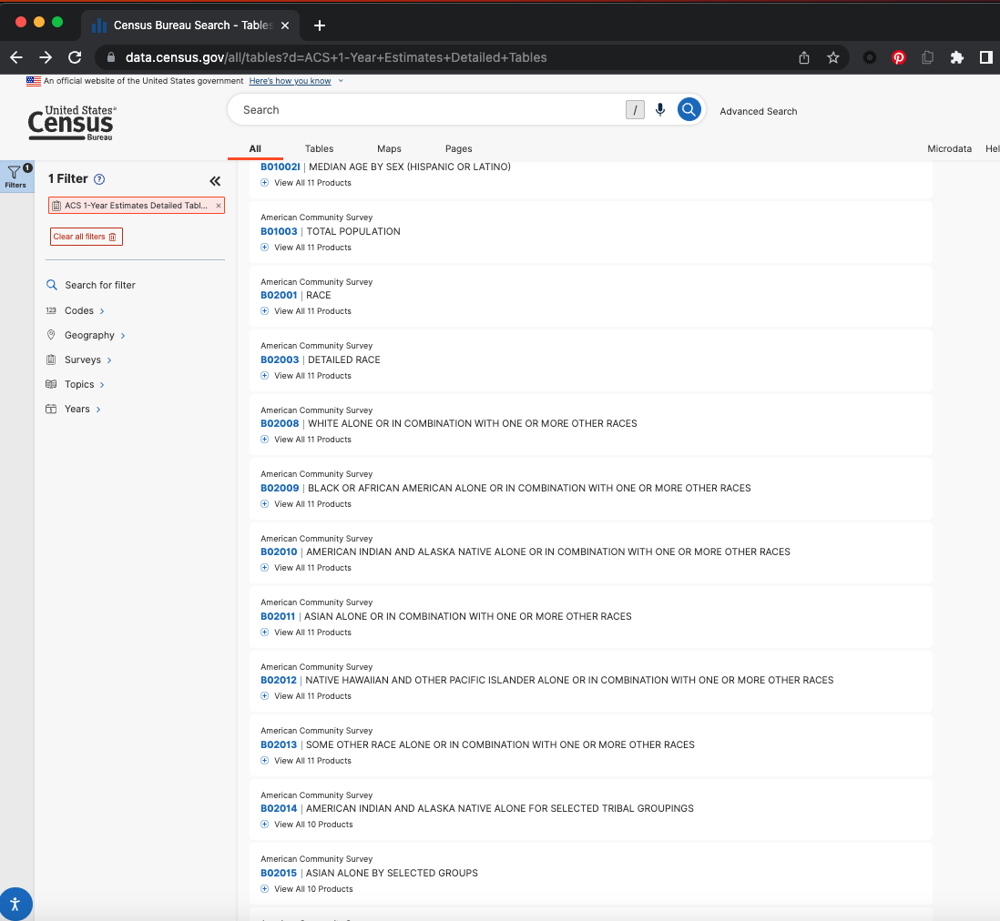

Requesting columns using the Census Bureau's API for tables in 2021 ACS in Florida

In [ ]:
# Setting a variable (con) for making a call to this specific table for Median Household Income.
con = cen.remote.APIConnection('ACSDT5Y2021',apikey=CENSUS_API_KEY)

# Looking at the variables available in this table.
variables = con.variables

# Identify the columns to map. Included here is Median Household Income and total population
columns = [
    'B01003_001', # Total Population
    'B19013_001', # Median Household Income
    'B02008_001', # White Alone or in Combination With One or More Other Races
    'B02009_001', # Black or African American Alone or in Combination With One or More Other Races
    'B02010_001', # American Indian and Alaska Native Alone or in Combination With One or More Other Races
    'B02011_001', # Asian Alone or in Combination With One or More Other Races
    'B02012_001', # Native Hawaiian and Other Pacific Islander Alone or in Combination With One or More Other Races
    'B02013_001', # Some Other Race Alone or in Combination With One or More Other Races
    'B15003_001', # Total Population (25 years and over)
    'B15003_022', # Bachelor's Degree (25 years and over)
    'B25001_001', # Housing Units (vacant and occupied)
    'B25002_001', # Total occupied housing units (renter and owned)
    'B25002_003', # Total occupied housing units (owned)
    'B25035_001', # median year that housing units were built
    # 'B25035_004', # median year that owner-occupied housing units were built in a specific geographic area
    'B19083_001', # Gini Index
]

# Notice the E was absent from the columns identified. The E identifies the column as an estimate. But we also want to include margins of error with our estimate. Hence the code below.
columns_E = [i+'E' for i in columns]
columns_M = [i+'M' for i in columns]

# Define the units of geography, as well as a filter for what we are looking for.
# State codes can be found at https://www.census.gov/library/reference/code-lists/ansi/ansi-codes-for-states.html
# Can also use the Missouri Census Data Center, which has great resources for lookups - https://mcdc.missouri.edu/
# Geographies: zip code tabulation area, school district (elementary), school district (secondary), combined statistical area, congressional district, county, tract, block group
# Filters on the geography: filter to tracts within state and county = {'state':'12', 'county':'073'}

# g_unit = 'county'
g_unit = 'tract'
g_filter = {'state':'12'}

# Call the API for the tables/columns at the tract or county level for the state of Florida and save to a dataframe
FLACStracts = con.query(columns_E + columns_M, geo_unit=g_unit, geo_filter=g_filter)

In [ ]:
FLACStracts.head(3)

,B01003_001E,B19013_001E,B02008_001E,B02009_001E,B02010_001E,B02011_001E,B02012_001E,B02013_001E,B15003_001E,B15003_022E,...,B15003_001M,B15003_022M,B25001_001M,B25002_001M,B25002_003M,B25035_001M,B19083_001M,state,county,tract
0,4403,14427,3436,570,0,603,0,302,1178,406,...,345,276,372,372,173,7,0.1032,12,001,000201
1,4720,12222,3816,709,86,171,3,376,775,92,...,391,64,332,332,172,9,0.0739,12,001,000202
2,4296,40809,2833,1390,79,111,0,102,2890,953,...,667,340,258,258,178,4,0.0728,12,001,000301


In [ ]:
FLACStracts.shape

(5160, 33)

In [ ]:
# Setting a variable (con) for making a call to this specific table for Median Household Income.
con = cen.remote.APIConnection('ACSDT5Y2021',apikey=CENSUS_API_KEY)

# Looking at the variables available in this table.
variables = con.variables

# Identify the columns to map. Included here is Median Household Income and total population
columns = [
    'B01003_001', # Total Population
    'B19013_001', # Median Household Income
    'B02008_001', # White Alone or in Combination With One or More Other Races
    'B02009_001', # Black or African American Alone or in Combination With One or More Other Races
    'B02010_001', # American Indian and Alaska Native Alone or in Combination With One or More Other Races
    'B02011_001', # Asian Alone or in Combination With One or More Other Races
    'B02012_001', # Native Hawaiian and Other Pacific Islander Alone or in Combination With One or More Other Races
    'B02013_001', # Some Other Race Alone or in Combination With One or More Other Races
    'B15003_001', # Total Population (25 years and over)
    'B15003_022', # Bachelor's Degree (25 years and over)
    'B25001_001', # Housing Units (vacant and occupied)
    'B25002_001', # Total occupied housing units (renter and owned)
    'B25002_003', # Total occupied housing units (owned)
    'B25035_001', # median year that housing units were built
    # 'B25035_004', # median year that owner-occupied housing units were built in a specific geographic area
    'B19083_001', # Gini Index
]

# Notice the E was absent from the columns identified. The E identifies the column as an estimate. But we also want to include margins of error with our estimate. Hence the code below.
columns_E = [i+'E' for i in columns]
columns_M = [i+'M' for i in columns]

# Define the units of geography, as well as a filter for what we are looking for.
# State codes can be found at https://www.census.gov/library/reference/code-lists/ansi/ansi-codes-for-states.html
# Can also use the Missouri Census Data Center, which has great resources for lookups - https://mcdc.missouri.edu/
# Geographies: zip code tabulation area, school district (elementary), school district (secondary), combined statistical area, congressional district, county, tract, block group
# Filters on the geography: filter to tracts within state and county = {'state':'12', 'county':'073'}

g_unit = 'county'
# g_unit = 'tract'
g_filter = {'state':'12'}

# Call the API for the tables/columns at the tract or county level for the state of Florida and save to a dataframe
FLACScounty = con.query(columns_E + columns_M, geo_unit=g_unit, geo_filter=g_filter)

In [ ]:
FLACScounty.head(3)

,B01003_001E,B19013_001E,B02008_001E,B02009_001E,B02010_001E,B02011_001E,B02012_001E,B02013_001E,B15003_001E,B15003_022E,...,B02013_001M,B15003_001M,B15003_022M,B25001_001M,B25002_001M,B25002_003M,B25035_001M,B19083_001M,state,county
0,276171,53314,197559,60255,2635,20201,401,14067,169822,39331,...,1368,57,1653,470,470,1112,1,0.0101,12,001
1,28003,63860,24072,3814,1036,238,25,933,18947,1743,...,413,209,413,165,165,319,3,0.0268,12,003
2,181384,60473,152900,22367,3362,6131,640,6787,129219,21211,...,1024,186,1297,180,180,942,2,0.0115,12,005


In [ ]:
FLACScounty.shape

(67, 32)

#### Downloading 2020 County Census Data from TIGER FTP

Importing the geographic files — County level

In [ ]:
usGeo2020county = gpd.read_file('https://www2.census.gov/geo/tiger/GENZ2020/shp/cb_2020_us_county_5m.zip')

In [ ]:
usGeo2020county.crs

<Geographic 2D CRS: EPSG:4269>
Name: NAD83
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: North America - onshore and offshore: Canada - Alberta; British Columbia; Manitoba; New Brunswick; Newfoundland and Labrador; Northwest Territories; Nova Scotia; Nunavut; Ontario; Prince Edward Island; Quebec; Saskatchewan; Yukon. Puerto Rico. United States (USA) - Alabama; Alaska; Arizona; Arkansas; California; Colorado; Connecticut; Delaware; Florida; Georgia; Hawaii; Idaho; Illinois; Indiana; Iowa; Kansas; Kentucky; Louisiana; Maine; Maryland; Massachusetts; Michigan; Minnesota; Mississippi; Missouri; Montana; Nebraska; Nevada; New Hampshire; New Jersey; New Mexico; New York; North Carolina; North Dakota; Ohio; Oklahoma; Oregon; Pennsylvania; Rhode Island; South Carolina; South Dakota; Tennessee; Texas; Utah; Vermont; Virginia; Washington; West Virginia; Wisconsin; Wyoming. US Virgin Islands. British Virgin Islands

In [ ]:
usGeo2020county = usGeo2020county.set_crs('epsg:26917', allow_override=True)

In [ ]:
usGeo2020county.head(3)

,STATEFP,COUNTYFP,COUNTYNS,AFFGEOID,GEOID,NAME,NAMELSAD,STUSPS,STATE_NAME,LSAD,ALAND,AWATER,geometry
0,04,023,00040472,0500000US04023,04023,Santa Cruz,Santa Cruz County,AZ,Arizona,06,3201853240,3068237,"POLYGON ((-111.367 31.521, -111.184 31.521, -1..."
1,12,059,00295735,0500000US12059,12059,Holmes,Holmes County,FL,Florida,06,1240232910,26393540,"POLYGON ((-86.035 30.993, -85.999 30.993, -85...."
2,27,081,00659486,0500000US27081,27081,Lincoln,Lincoln County,MN,Minnesota,06,1390265112,30167787,"POLYGON ((-96.453 44.197, -96.453 44.255, -96...."


In [ ]:
alt.Chart(usGeo2020county).mark_geoshape()

alt.Chart(...)

Importing census tract level data

In [ ]:
usGeo2020tracts = gpd.read_file('https://www2.census.gov/geo/tiger/GENZ2020/shp/cb_2020_us_tract_500k.zip')

In [ ]:
usGeo2020tracts.crs

<Geographic 2D CRS: EPSG:4269>
Name: NAD83
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: North America - onshore and offshore: Canada - Alberta; British Columbia; Manitoba; New Brunswick; Newfoundland and Labrador; Northwest Territories; Nova Scotia; Nunavut; Ontario; Prince Edward Island; Quebec; Saskatchewan; Yukon. Puerto Rico. United States (USA) - Alabama; Alaska; Arizona; Arkansas; California; Colorado; Connecticut; Delaware; Florida; Georgia; Hawaii; Idaho; Illinois; Indiana; Iowa; Kansas; Kentucky; Louisiana; Maine; Maryland; Massachusetts; Michigan; Minnesota; Mississippi; Missouri; Montana; Nebraska; Nevada; New Hampshire; New Jersey; New Mexico; New York; North Carolina; North Dakota; Ohio; Oklahoma; Oregon; Pennsylvania; Rhode Island; South Carolina; South Dakota; Tennessee; Texas; Utah; Vermont; Virginia; Washington; West Virginia; Wisconsin; Wyoming. US Virgin Islands. British Virgin Islands

In [ ]:
usGeo2020tracts = usGeo2020tracts.set_crs('epsg:26917', allow_override=True)

In [ ]:
usGeo2020tracts.shape

(85188, 14)

In [ ]:
usGeo2020tracts.head(3)

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,NAMELSAD,STUSPS,NAMELSADCO,STATE_NAME,LSAD,ALAND,AWATER,geometry
0,06,077,005127,1400000US06077005127,06077005127,51.27,Census Tract 51.27,CA,San Joaquin County,California,CT,1960015,0,"POLYGON ((-121.287 37.834, -121.285 37.843, -1..."
1,06,077,003406,1400000US06077003406,06077003406,34.06,Census Tract 34.06,CA,San Joaquin County,California,CT,839414,14789,"POLYGON ((-121.309 38.028, -121.305 38.028, -1..."
2,06,077,004402,1400000US06077004402,06077004402,44.02,Census Tract 44.02,CA,San Joaquin County,California,CT,4346363,0,"POLYGON ((-121.273 38.108, -121.273 38.116, -1..."


Filtering the data just to Florida counties

In [ ]:
FLcounties = usGeo2020county.loc[usGeo2020county['STATEFP'] == '12'].reset_index(drop=True)

Filtering the data just to Florida Census tracts

In [ ]:
FLtracts = usGeo2020tracts.loc[usGeo2020tracts['STATEFP'] == '12'].reset_index(drop=True)

In [ ]:
FLtracts.shape

(5122, 14)

Filtering the data just to only Pinellas County, FL Census tracts

In [ ]:
pc_tracts = FLtracts.loc[FLtracts['COUNTYFP'] == '103'].reset_index(drop=True)

In [ ]:
pc_tracts.shape

(273, 14)

In [ ]:
pc_tracts.head(5)

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,NAMELSAD,STUSPS,NAMELSADCO,STATE_NAME,LSAD,ALAND,AWATER,geometry
0,12,103,025107,1400000US12103025107,12103025107,251.07,Census Tract 251.07,FL,Pinellas County,Florida,CT,2413826,876417,"POLYGON ((-82.787 27.840, -82.781 27.839, -82...."
1,12,103,026904,1400000US12103026904,12103026904,269.04,Census Tract 269.04,FL,Pinellas County,Florida,CT,2758139,59458,"POLYGON ((-82.747 28.049, -82.743 28.049, -82...."
2,12,103,022801,1400000US12103022801,12103022801,228.01,Census Tract 228.01,FL,Pinellas County,Florida,CT,2033690,19357,"POLYGON ((-82.700 27.806, -82.700 27.808, -82...."
3,12,103,023700,1400000US12103023700,12103023700,237,Census Tract 237,FL,Pinellas County,Florida,CT,1166292,537490,"POLYGON ((-82.639 27.786, -82.639 27.788, -82...."
4,12,103,025012,1400000US12103025012,12103025012,250.12,Census Tract 250.12,FL,Pinellas County,Florida,CT,3905048,145643,"POLYGON ((-82.762 27.865, -82.762 27.869, -82...."


#### Merging ACS + Geography Data


Geography datasets

In [ ]:
FLcounties.head(2)

,STATEFP,COUNTYFP,COUNTYNS,AFFGEOID,GEOID,NAME,NAMELSAD,STUSPS,STATE_NAME,LSAD,ALAND,AWATER,geometry
0,12,059,00295735,0500000US12059,12059,Holmes,Holmes County,FL,Florida,06,1240232910,26393540,"POLYGON ((-86.035 30.993, -85.999 30.993, -85...."
1,12,067,00295732,0500000US12067,12067,Lafayette,Lafayette County,FL,Florida,06,1407256302,11817999,"POLYGON ((-83.369 30.187, -83.367 30.201, -83...."


In [ ]:
FLtracts.head(2)

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,NAMELSAD,STUSPS,NAMELSADCO,STATE_NAME,LSAD,ALAND,AWATER,geometry
0,12,031,001500,1400000US12031001500,12031001500,15,Census Tract 15,FL,Duval County,Florida,CT,1930546,0,"POLYGON ((-81.680 30.366, -81.677 30.366, -81...."
1,12,031,011600,1400000US12031011600,12031011600,116,Census Tract 116,FL,Duval County,Florida,CT,4027498,9843,"POLYGON ((-81.731 30.374, -81.730 30.373, -81...."


In [ ]:
pc_tracts.head(2)

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,NAMELSAD,STUSPS,NAMELSADCO,STATE_NAME,LSAD,ALAND,AWATER,geometry
0,12,103,025107,1400000US12103025107,12103025107,251.07,Census Tract 251.07,FL,Pinellas County,Florida,CT,2413826,876417,"POLYGON ((-82.787 27.840, -82.781 27.839, -82...."
1,12,103,026904,1400000US12103026904,12103026904,269.04,Census Tract 269.04,FL,Pinellas County,Florida,CT,2758139,59458,"POLYGON ((-82.747 28.049, -82.743 28.049, -82...."


ACS datasets

In [ ]:
FLACScounty.head(2)

,B01003_001E,B19013_001E,B02008_001E,B02009_001E,B02010_001E,B02011_001E,B02012_001E,B02013_001E,B15003_001E,B15003_022E,...,B02013_001M,B15003_001M,B15003_022M,B25001_001M,B25002_001M,B25002_003M,B25035_001M,B19083_001M,state,county
0,276171,53314,197559,60255,2635,20201,401,14067,169822,39331,...,1368,57,1653,470,470,1112,1,0.0101,12,001
1,28003,63860,24072,3814,1036,238,25,933,18947,1743,...,413,209,413,165,165,319,3,0.0268,12,003


In [ ]:
FLACStracts.head(2)

,B01003_001E,B19013_001E,B02008_001E,B02009_001E,B02010_001E,B02011_001E,B02012_001E,B02013_001E,B15003_001E,B15003_022E,...,B15003_001M,B15003_022M,B25001_001M,B25002_001M,B25002_003M,B25035_001M,B19083_001M,state,county,tract
0,4403,14427,3436,570,0,603,0,302,1178,406,...,345,276,372,372,173,7,0.1032,12,001,000201
1,4720,12222,3816,709,86,171,3,376,775,92,...,391,64,332,332,172,9,0.0739,12,001,000202


Create a unique GEOID to merge on for each county

In [ ]:
FLACScounty['GEOID'] = FLACScounty['state'] + FLACScounty['county']

In [ ]:
FLACScounty.columns

Index(['B01003_001E', 'B19013_001E', 'B02008_001E', 'B02009_001E',
       'B02010_001E', 'B02011_001E', 'B02012_001E', 'B02013_001E',
       'B15003_001E', 'B15003_022E', 'B25001_001E', 'B25002_001E',
       'B25002_003E', 'B25035_001E', 'B19083_001E', 'B01003_001M',
       'B19013_001M', 'B02008_001M', 'B02009_001M', 'B02010_001M',
       'B02011_001M', 'B02012_001M', 'B02013_001M', 'B15003_001M',
       'B15003_022M', 'B25001_001M', 'B25002_001M', 'B25002_003M',
       'B25035_001M', 'B19083_001M', 'state', 'county', 'GEOID'],
      dtype='object')

Create a unique GEOID to merge on for each census tract

In [ ]:
FLACStracts['GEOID'] = FLACStracts['state'] + FLACStracts['county'] + FLACStracts['tract']

In [ ]:
FLACStracts.columns

Index(['B01003_001E', 'B19013_001E', 'B02008_001E', 'B02009_001E',
       'B02010_001E', 'B02011_001E', 'B02012_001E', 'B02013_001E',
       'B15003_001E', 'B15003_022E', 'B25001_001E', 'B25002_001E',
       'B25002_003E', 'B25035_001E', 'B19083_001E', 'B01003_001M',
       'B19013_001M', 'B02008_001M', 'B02009_001M', 'B02010_001M',
       'B02011_001M', 'B02012_001M', 'B02013_001M', 'B15003_001M',
       'B15003_022M', 'B25001_001M', 'B25002_001M', 'B25002_003M',
       'B25035_001M', 'B19083_001M', 'state', 'county', 'tract', 'GEOID'],
      dtype='object')

Merge FL county ACS data and geography data

In [ ]:
FLcounty = FLcounties.merge(FLACScounty, on='GEOID')

In [ ]:
FLcounty.shape

(67, 45)

In [ ]:
FLcounty.columns

Index(['STATEFP', 'COUNTYFP', 'COUNTYNS', 'AFFGEOID', 'GEOID', 'NAME',
       'NAMELSAD', 'STUSPS', 'STATE_NAME', 'LSAD', 'ALAND', 'AWATER',
       'geometry', 'B01003_001E', 'B19013_001E', 'B02008_001E', 'B02009_001E',
       'B02010_001E', 'B02011_001E', 'B02012_001E', 'B02013_001E',
       'B15003_001E', 'B15003_022E', 'B25001_001E', 'B25002_001E',
       'B25002_003E', 'B25035_001E', 'B19083_001E', 'B01003_001M',
       'B19013_001M', 'B02008_001M', 'B02009_001M', 'B02010_001M',
       'B02011_001M', 'B02012_001M', 'B02013_001M', 'B15003_001M',
       'B15003_022M', 'B25001_001M', 'B25002_001M', 'B25002_003M',
       'B25035_001M', 'B19083_001M', 'state', 'county'],
      dtype='object')

Merge FL census tract ACS data and geography data

In [ ]:
FLtract = FLtracts.merge(FLACStracts, on='GEOID')

In [ ]:
FLtract.shape

(5122, 47)

In [ ]:
FLtract.columns

Index(['STATEFP', 'COUNTYFP', 'TRACTCE', 'AFFGEOID', 'GEOID', 'NAME',
       'NAMELSAD', 'STUSPS', 'NAMELSADCO', 'STATE_NAME', 'LSAD', 'ALAND',
       'AWATER', 'geometry', 'B01003_001E', 'B19013_001E', 'B02008_001E',
       'B02009_001E', 'B02010_001E', 'B02011_001E', 'B02012_001E',
       'B02013_001E', 'B15003_001E', 'B15003_022E', 'B25001_001E',
       'B25002_001E', 'B25002_003E', 'B25035_001E', 'B19083_001E',
       'B01003_001M', 'B19013_001M', 'B02008_001M', 'B02009_001M',
       'B02010_001M', 'B02011_001M', 'B02012_001M', 'B02013_001M',
       'B15003_001M', 'B15003_022M', 'B25001_001M', 'B25002_001M',
       'B25002_003M', 'B25035_001M', 'B19083_001M', 'state', 'county',
       'tract'],
      dtype='object')

In [ ]:
alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

In [ ]:
# alt.Chart(FLtract).mark_geoshape()

Merge FL census tract ACS data and geography data only for Pinellas County, FL

In [ ]:
pc_tract = pc_tracts.merge(FLACStracts, on='GEOID')

In [ ]:
pc_tract.shape

(273, 47)

In [ ]:
pc_tract.columns

Index(['STATEFP', 'COUNTYFP', 'TRACTCE', 'AFFGEOID', 'GEOID', 'NAME',
       'NAMELSAD', 'STUSPS', 'NAMELSADCO', 'STATE_NAME', 'LSAD', 'ALAND',
       'AWATER', 'geometry', 'B01003_001E', 'B19013_001E', 'B02008_001E',
       'B02009_001E', 'B02010_001E', 'B02011_001E', 'B02012_001E',
       'B02013_001E', 'B15003_001E', 'B15003_022E', 'B25001_001E',
       'B25002_001E', 'B25002_003E', 'B25035_001E', 'B19083_001E',
       'B01003_001M', 'B19013_001M', 'B02008_001M', 'B02009_001M',
       'B02010_001M', 'B02011_001M', 'B02012_001M', 'B02013_001M',
       'B15003_001M', 'B15003_022M', 'B25001_001M', 'B25002_001M',
       'B25002_003M', 'B25035_001M', 'B19083_001M', 'state', 'county',
       'tract'],
      dtype='object')

In [ ]:
alt.Chart(pc_tract).mark_geoshape()

alt.Chart(...)

#### Cleaning up datasets

In [ ]:
pd.reset_option('display.max_colwidth')

In [ ]:
    # 'B01003_001', # Total Population
    # 'B19013_001', # Median Household Income
    # 'B02008_001', # White Alone or in Combination With One or More Other Races
    # 'B02009_001', # Black or African American Alone or in Combination With One or More Other Races
    # 'B02010_001', # American Indian and Alaska Native Alone or in Combination With One or More Other Races
    # 'B02011_001', # Asian Alone or in Combination With One or More Other Races
    # 'B02012_001', # Native Hawaiian and Other Pacific Islander Alone or in Combination With One or More Other Races
    # 'B02013_001', # Some Other Race Alone or in Combination With One or More Other Races
    # 'B15003_001', # Total Population (25 years and over)
    # 'B15003_022', # Bachelor's Degree (25 years and over)
    # 'B25002_001', # Total occupied housing units (renter and owned)
    # 'B25002_003', # Total occupied housing units (owned)
    # 'B25035_001', # median year that housing units were built
    # # 'B25035_004', # median year that owner-occupied housing units were built in a specific geographic area
    # 'B19083_001', # Gini Index

FLCounty: renaming columns and converting to integers

In [ ]:
FLcounty.columns

Index(['STATEFP', 'COUNTYFP', 'COUNTYNS', 'AFFGEOID', 'GEOID', 'NAME',
       'NAMELSAD', 'STUSPS', 'STATE_NAME', 'LSAD', 'ALAND', 'AWATER',
       'geometry', 'B01003_001E', 'B19013_001E', 'B02008_001E', 'B02009_001E',
       'B02010_001E', 'B02011_001E', 'B02012_001E', 'B02013_001E',
       'B15003_001E', 'B15003_022E', 'B25001_001E', 'B25002_001E',
       'B25002_003E', 'B25035_001E', 'B19083_001E', 'B01003_001M',
       'B19013_001M', 'B02008_001M', 'B02009_001M', 'B02010_001M',
       'B02011_001M', 'B02012_001M', 'B02013_001M', 'B15003_001M',
       'B15003_022M', 'B25001_001M', 'B25002_001M', 'B25002_003M',
       'B25035_001M', 'B19083_001M', 'state', 'county'],
      dtype='object')

In [ ]:
#     'B25001_001'

In [ ]:
FLcounty.rename(columns = {'B01003_001E':'totPop', 'B02008_001E':'white', 'B02009_001E':'blackaa', 'B02010_001E':'aian', 'B02011_001E':'asian', 'B02012_001E':'nhpi', 'B02013_001E':'other', 'B19013_001E':'hhincome', 'B15003_001E':'pop_twenty_five_up', 'B15003_022E':'bachelors', 'B25001_001E': 'housing_units', 'B25002_001E':'occupied_homes', 'B25002_003E': 'owner_occupied_homes', 'B25035_001E':'housing_built_med_year', 'B19083_001E':'gini'}, inplace = True)
FLcounty.drop(FLcounty.index[0]).reset_index(drop=True)

,STATEFP,COUNTYFP,COUNTYNS,AFFGEOID,GEOID,NAME,NAMELSAD,STUSPS,STATE_NAME,LSAD,...,B02013_001M,B15003_001M,B15003_022M,B25001_001M,B25002_001M,B25002_003M,B25035_001M,B19083_001M,state,county
0,12,067,00295732,0500000US12067,12067,Lafayette,Lafayette County,FL,Florida,06,...,233,311,171,219,219,215,4,0.0375,12,067
1,12,033,00295737,0500000US12033,12033,Escambia,Escambia County,FL,Florida,06,...,1173,126,1642,342,342,1119,2,0.0082,12,033
2,12,111,00308372,0500000US12111,12111,St. Lucie,St. Lucie County,FL,Florida,06,...,3204,413,1871,234,234,1430,1,0.0271,12,111
3,12,013,00306919,0500000US12013,12013,Calhoun,Calhoun County,FL,Florida,06,...,216,108,201,145,145,218,3,0.0517,12,013
4,12,069,00308551,0500000US12069,12069,Lake,Lake County,FL,Florida,06,...,2983,253,2496,201,201,1455,2,0.0105,12,069
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61,12,021,00295754,0500000US12021,12021,Collier,Collier County,FL,Florida,06,...,2985,139,2345,264,264,2226,1,0.0089,12,021
62,12,071,00295758,0500000US12071,12071,Lee,Lee County,FL,Florida,06,...,3308,120,3029,461,461,2389,2,0.0065,12,071
63,12,103,00295745,0500000US12103,12103,Pinellas,Pinellas County,FL,Florida,06,...,2334,127,3407,545,545,2353,1,0.0055,12,103
64,12,007,00303634,0500000US12007,12007,Bradford,Bradford County,FL,Florida,06,...,183,219,320,311,311,376,3,0.0362,12,007


In [ ]:
FLcounty.housing_units.head(5)

0      8639
1      3406
2    144698
3    146077
4      5704
Name: housing_units, dtype: object

In [ ]:
FLcounty.occupied_homes.head(5)

0      8639
1      3406
2    144698
3    146077
4      5704
Name: occupied_homes, dtype: object

In [ ]:
FLcounty.dtypes

STATEFP                     object
COUNTYFP                    object
COUNTYNS                    object
AFFGEOID                    object
GEOID                       object
NAME                        object
NAMELSAD                    object
STUSPS                      object
STATE_NAME                  object
LSAD                        object
ALAND                        int64
AWATER                       int64
geometry                  geometry
totPop                      object
hhincome                    object
white                       object
blackaa                     object
aian                        object
asian                       object
nhpi                        object
other                       object
pop_twenty_five_up          object
bachelors                   object
housing_units               object
occupied_homes              object
owner_occupied_homes        object
housing_built_med_year      object
gini                        object
B01003_001M         

Convert columns to float

In [ ]:
FLcounty[['totPop', 'white', 'blackaa', 'aian', 'asian', 'nhpi', 'other', 'hhincome', 'pop_twenty_five_up','bachelors', 'housing_units', 'occupied_homes', 'owner_occupied_homes', 'housing_built_med_year', 'gini']] = FLcounty[['totPop', 'white', 'blackaa', 'aian', 'asian', 'nhpi', 'other', 'hhincome', 'pop_twenty_five_up','bachelors', 'housing_units', 'occupied_homes', 'owner_occupied_homes', 'housing_built_med_year', 'gini']].astype('float')

In [ ]:
FLcounty.dtypes

STATEFP                     object
COUNTYFP                    object
COUNTYNS                    object
AFFGEOID                    object
GEOID                       object
NAME                        object
NAMELSAD                    object
STUSPS                      object
STATE_NAME                  object
LSAD                        object
ALAND                        int64
AWATER                       int64
geometry                  geometry
totPop                     float64
hhincome                   float64
white                      float64
blackaa                    float64
aian                       float64
asian                      float64
nhpi                       float64
other                      float64
pop_twenty_five_up         float64
bachelors                  float64
housing_units              float64
occupied_homes             float64
owner_occupied_homes       float64
housing_built_med_year     float64
gini                       float64
B01003_001M         

FLtract: renaming columns

In [ ]:
FLtract.columns

Index(['STATEFP', 'COUNTYFP', 'TRACTCE', 'AFFGEOID', 'GEOID', 'NAME',
       'NAMELSAD', 'STUSPS', 'NAMELSADCO', 'STATE_NAME', 'LSAD', 'ALAND',
       'AWATER', 'geometry', 'B01003_001E', 'B19013_001E', 'B02008_001E',
       'B02009_001E', 'B02010_001E', 'B02011_001E', 'B02012_001E',
       'B02013_001E', 'B15003_001E', 'B15003_022E', 'B25001_001E',
       'B25002_001E', 'B25002_003E', 'B25035_001E', 'B19083_001E',
       'B01003_001M', 'B19013_001M', 'B02008_001M', 'B02009_001M',
       'B02010_001M', 'B02011_001M', 'B02012_001M', 'B02013_001M',
       'B15003_001M', 'B15003_022M', 'B25001_001M', 'B25002_001M',
       'B25002_003M', 'B25035_001M', 'B19083_001M', 'state', 'county',
       'tract'],
      dtype='object')

In [ ]:
FLtract.rename(columns = {'B01003_001E':'totPop', 'B02008_001E':'white', 'B02009_001E':'blackaa', 'B02010_001E':'aian', 'B02011_001E':'asian', 'B02012_001E':'nhpi', 'B02013_001E':'other', 'B19013_001E':'hhincome', 'B15003_001E':'pop_twenty_five_up', 'B15003_022E':'bachelors', 'B25001_001E': 'housing_units', 'B25002_001E':'occupied_homes', 'B25002_003E': 'owner_occupied_homes', 'B25035_001E':'housing_built_med_year', 'B19083_001E':'gini'}, inplace = True)
FLtract.drop(FLtract.index[0]).reset_index(drop=True)

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,NAMELSAD,STUSPS,NAMELSADCO,STATE_NAME,...,B15003_001M,B15003_022M,B25001_001M,B25002_001M,B25002_003M,B25035_001M,B19083_001M,state,county,tract
0,12,031,011600,1400000US12031011600,12031011600,116,Census Tract 116,FL,Duval County,Florida,...,455,93,189,189,107,2,0.0586,12,031,011600
1,12,031,012900,1400000US12031012900,12031012900,129,Census Tract 129,FL,Duval County,Florida,...,339,67,173,173,19,2,0.1247,12,031,012900
2,12,031,015200,1400000US12031015200,12031015200,152,Census Tract 152,FL,Duval County,Florida,...,543,256,312,312,91,2,0.1125,12,031,015200
3,12,047,960300,1400000US12047960300,12047960300,9603,Census Tract 9603,FL,Hamilton County,Florida,...,195,63,113,113,60,5,0.0547,12,047,960300
4,12,005,002200,1400000US12005002200,12005002200,22,Census Tract 22,FL,Bay County,Florida,...,425,222,211,211,130,11,0.0554,12,005,002200
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5116,12,095,016736,1400000US12095016736,12095016736,167.36,Census Tract 167.36,FL,Orange County,Florida,...,1031,614,491,491,404,1,0.0742,12,095,016736
5117,12,097,041004,1400000US12097041004,12097041004,410.04,Census Tract 410.04,FL,Osceola County,Florida,...,867,175,164,164,238,2,0.0653,12,097,041004
5118,12,057,005500,1400000US12057005500,12057005500,55,Census Tract 55,FL,Hillsborough County,Florida,...,266,204,156,156,100,4,0.0515,12,057,005500
5119,12,057,011610,1400000US12057011610,12057011610,116.10,Census Tract 116.10,FL,Hillsborough County,Florida,...,688,274,361,361,220,5,0.0907,12,057,011610


In [ ]:
FLtract.columns


Index(['STATEFP', 'COUNTYFP', 'TRACTCE', 'AFFGEOID', 'GEOID', 'NAME',
       'NAMELSAD', 'STUSPS', 'NAMELSADCO', 'STATE_NAME', 'LSAD', 'ALAND',
       'AWATER', 'geometry', 'totPop', 'hhincome', 'white', 'blackaa', 'aian',
       'asian', 'nhpi', 'other', 'pop_twenty_five_up', 'bachelors',
       'housing_units', 'occupied_homes', 'owner_occupied_homes',
       'housing_built_med_year', 'gini', 'B01003_001M', 'B19013_001M',
       'B02008_001M', 'B02009_001M', 'B02010_001M', 'B02011_001M',
       'B02012_001M', 'B02013_001M', 'B15003_001M', 'B15003_022M',
       'B25001_001M', 'B25002_001M', 'B25002_003M', 'B25035_001M',
       'B19083_001M', 'state', 'county', 'tract'],
      dtype='object')

Convert columns to float

In [ ]:
FLtract[['totPop', 'white', 'blackaa', 'aian', 'asian', 'nhpi', 'other', 'hhincome', 'pop_twenty_five_up','bachelors', 'housing_units', 'occupied_homes', 'owner_occupied_homes', 'housing_built_med_year', 'gini']] = FLtract[['totPop', 'white', 'blackaa', 'aian', 'asian', 'nhpi', 'other', 'hhincome', 'pop_twenty_five_up','bachelors', 'housing_units', 'occupied_homes', 'owner_occupied_homes', 'housing_built_med_year', 'gini']].astype('float')

In [ ]:
FLtract.dtypes

STATEFP                     object
COUNTYFP                    object
TRACTCE                     object
AFFGEOID                    object
GEOID                       object
NAME                        object
NAMELSAD                    object
STUSPS                      object
NAMELSADCO                  object
STATE_NAME                  object
LSAD                        object
ALAND                        int64
AWATER                       int64
geometry                  geometry
totPop                     float64
hhincome                   float64
white                      float64
blackaa                    float64
aian                       float64
asian                      float64
nhpi                       float64
other                      float64
pop_twenty_five_up         float64
bachelors                  float64
housing_units              float64
occupied_homes             float64
owner_occupied_homes       float64
housing_built_med_year     float64
gini                

pc_tract: renaming columns

In [ ]:
pc_tract.columns

Index(['STATEFP', 'COUNTYFP', 'TRACTCE', 'AFFGEOID', 'GEOID', 'NAME',
       'NAMELSAD', 'STUSPS', 'NAMELSADCO', 'STATE_NAME', 'LSAD', 'ALAND',
       'AWATER', 'geometry', 'B01003_001E', 'B19013_001E', 'B02008_001E',
       'B02009_001E', 'B02010_001E', 'B02011_001E', 'B02012_001E',
       'B02013_001E', 'B15003_001E', 'B15003_022E', 'B25001_001E',
       'B25002_001E', 'B25002_003E', 'B25035_001E', 'B19083_001E',
       'B01003_001M', 'B19013_001M', 'B02008_001M', 'B02009_001M',
       'B02010_001M', 'B02011_001M', 'B02012_001M', 'B02013_001M',
       'B15003_001M', 'B15003_022M', 'B25001_001M', 'B25002_001M',
       'B25002_003M', 'B25035_001M', 'B19083_001M', 'state', 'county',
       'tract'],
      dtype='object')

In [ ]:
pc_tract.rename(columns = {'B01003_001E':'totPop', 'B02008_001E':'white', 'B02009_001E':'blackaa', 'B02010_001E':'aian', 'B02011_001E':'asian', 'B02012_001E':'nhpi', 'B02013_001E':'other', 'B19013_001E':'hhincome', 'B15003_001E':'pop_twenty_five_up', 'B15003_022E':'bachelors', 'B25001_001E': 'housing_units', 'B25002_001E':'occupied_homes', 'B25002_003E': 'owner_occupied_homes', 'B25035_001E':'housing_built_med_year', 'B19083_001E':'gini'}, inplace = True)
pc_tract.drop(pc_tract.index[0]).reset_index(drop=True)

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,NAMELSAD,STUSPS,NAMELSADCO,STATE_NAME,...,B15003_001M,B15003_022M,B25001_001M,B25002_001M,B25002_003M,B25035_001M,B19083_001M,state,county,tract
0,12,103,026904,1400000US12103026904,12103026904,269.04,Census Tract 269.04,FL,Pinellas County,Florida,...,596,189,268,268,154,3,0.0977,12,103,026904
1,12,103,022801,1400000US12103022801,12103022801,228.01,Census Tract 228.01,FL,Pinellas County,Florida,...,446,159,330,330,84,4,0.0577,12,103,022801
2,12,103,023700,1400000US12103023700,12103023700,237,Census Tract 237,FL,Pinellas County,Florida,...,400,170,339,339,98,3,0.0741,12,103,023700
3,12,103,025012,1400000US12103025012,12103025012,250.12,Census Tract 250.12,FL,Pinellas County,Florida,...,406,270,243,243,133,2,0.0591,12,103,025012
4,12,103,020600,1400000US12103020600,12103020600,206,Census Tract 206,FL,Pinellas County,Florida,...,573,161,246,246,143,3,0.1105,12,103,020600
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
267,12,103,025700,1400000US12103025700,12103025700,257,Census Tract 257,FL,Pinellas County,Florida,...,137,189,130,130,128,3,0.0619,12,103,025700
268,12,103,025122,1400000US12103025122,12103025122,251.22,Census Tract 251.22,FL,Pinellas County,Florida,...,386,375,110,110,140,3,0.0615,12,103,025122
269,12,103,027324,1400000US12103027324,12103027324,273.24,Census Tract 273.24,FL,Pinellas County,Florida,...,353,165,182,182,76,2,0.1248,12,103,027324
270,12,103,027905,1400000US12103027905,12103027905,279.05,Census Tract 279.05,FL,Pinellas County,Florida,...,308,225,264,264,183,3,0.0366,12,103,027905


In [ ]:
pc_tract.columns

Index(['STATEFP', 'COUNTYFP', 'TRACTCE', 'AFFGEOID', 'GEOID', 'NAME',
       'NAMELSAD', 'STUSPS', 'NAMELSADCO', 'STATE_NAME', 'LSAD', 'ALAND',
       'AWATER', 'geometry', 'totPop', 'hhincome', 'white', 'blackaa', 'aian',
       'asian', 'nhpi', 'other', 'pop_twenty_five_up', 'bachelors',
       'housing_units', 'occupied_homes', 'owner_occupied_homes',
       'housing_built_med_year', 'gini', 'B01003_001M', 'B19013_001M',
       'B02008_001M', 'B02009_001M', 'B02010_001M', 'B02011_001M',
       'B02012_001M', 'B02013_001M', 'B15003_001M', 'B15003_022M',
       'B25001_001M', 'B25002_001M', 'B25002_003M', 'B25035_001M',
       'B19083_001M', 'state', 'county', 'tract'],
      dtype='object')

Convert columns to float

In [ ]:
pc_tract[['totPop', 'white', 'blackaa', 'aian', 'asian', 'nhpi', 'other', 'hhincome', 'pop_twenty_five_up','bachelors', 'housing_units', 'occupied_homes', 'owner_occupied_homes', 'housing_built_med_year', 'gini']] = pc_tract[['totPop', 'white', 'blackaa', 'aian', 'asian', 'nhpi', 'other', 'hhincome', 'pop_twenty_five_up','bachelors', 'housing_units', 'occupied_homes', 'owner_occupied_homes', 'housing_built_med_year', 'gini']].astype('float')

In [ ]:
pc_tract.dtypes

STATEFP                     object
COUNTYFP                    object
TRACTCE                     object
AFFGEOID                    object
GEOID                       object
NAME                        object
NAMELSAD                    object
STUSPS                      object
NAMELSADCO                  object
STATE_NAME                  object
LSAD                        object
ALAND                        int64
AWATER                       int64
geometry                  geometry
totPop                     float64
hhincome                   float64
white                      float64
blackaa                    float64
aian                       float64
asian                      float64
nhpi                       float64
other                      float64
pop_twenty_five_up         float64
bachelors                  float64
housing_units              float64
occupied_homes             float64
owner_occupied_homes       float64
housing_built_med_year     float64
gini                

#### Percentages

Creating a column for the percentage of the total population that is Black/African-American

In [ ]:
# df['Black Percentage'] = df['Black Population'] / df['Total Population'] * 100

In [ ]:
pc_tract['blackaa_pct'] = pc_tract['blackaa'] / pc_tract['totPop'] * 100

Creating a column for the percentage of the population 25+ that received a bachelors degree, a variable to compare education levels across areas

In [ ]:
pc_tract['bachelors_pct'] = pc_tract['bachelors'] / pc_tract['pop_twenty_five_up'] * 100

In [ ]:
pc_tract.columns

Index(['STATEFP', 'COUNTYFP', 'TRACTCE', 'AFFGEOID', 'GEOID', 'NAME',
       'NAMELSAD', 'STUSPS', 'NAMELSADCO', 'STATE_NAME', 'LSAD', 'ALAND',
       'AWATER', 'geometry', 'totPop', 'hhincome', 'white', 'blackaa', 'aian',
       'asian', 'nhpi', 'other', 'pop_twenty_five_up', 'bachelors',
       'housing_units', 'occupied_homes', 'owner_occupied_homes',
       'housing_built_med_year', 'gini', 'B01003_001M', 'B19013_001M',
       'B02008_001M', 'B02009_001M', 'B02010_001M', 'B02011_001M',
       'B02012_001M', 'B02013_001M', 'B15003_001M', 'B15003_022M',
       'B25001_001M', 'B25002_001M', 'B25002_003M', 'B25035_001M',
       'B19083_001M', 'state', 'county', 'tract', 'blackaa_pct',
       'bachelors_pct'],
      dtype='object')

----

#### Breaks

Determining breaks in the data for mapping purposes

In [ ]:
pc_tract.blackaa_pct.describe()

count    273.000000
mean      11.934130
std       17.338763
min        0.000000
25%        2.373418
50%        5.783009
75%       13.213213
max       90.480185
Name: blackaa_pct, dtype: float64

In [ ]:
pc_tract['blackaa_pct']

0      4.096081
1      2.739101
2      7.750583
3      9.692860
4      5.144440
         ...   
268    0.694611
269    0.856002
270    2.892849
271    1.961639
272    1.939334
Name: blackaa_pct, Length: 273, dtype: float64

In [ ]:
import jenkspy

Quantile binning: Divide the data into bins based on quantiles. For example, you could specify that you want to divide your data into quartiles or deciles. Here there are 8 bins even though the column is named quartile.

In [ ]:
pc_tract['quantile'] = pd.qcut(pc_tract['blackaa_pct'], q=8, labels=['bucket_1', 'bucket_2', 'bucket_3', 'bucket_4', 'bucket_5', 'bucket_6', 'bucket_7', 'bucket_8'])

In [ ]:
# pc_tract.quantile

What does this look like if this column is divided by eight bins?

In [ ]:
pcblackaaMap2 = alt.Chart(pc_tract).mark_geoshape().encode(
    color=alt.Color('quantile', legend=alt.Legend(title='Black/African-American Population'), scale=alt.Scale(scheme='bluepurple')),
    tooltip=[alt.Tooltip('NAMELSAD',title='Area'),
      alt.Tooltip('totPop',title='Population', format=','),
      alt.Tooltip('blackaa',title='blackaa')]
).properties(
    width=500,
    height=500,
    title='Black/African-American Population 2021 ACS data (Pinellas County)'
).project(
    type='conicConformal',
    parallels=[45 + 37 / 60, 47 + 3 / 60],
    rotate=[94 + 15 / 60, 0]
)

pcblackaaMap2

alt.Chart(...)

Equal-width binning: Divide the data into equally sized intervals. For example, you could specify a range for your data and then divide it into a certain number of equally sized bins.

In [ ]:
# Calculate equal-width bins
bins = pd.cut(pc_tract['blackaa_pct'], bins=7)

# Print the bins
print(bins)

0      (-0.0905, 12.926]
1      (-0.0905, 12.926]
2      (-0.0905, 12.926]
3      (-0.0905, 12.926]
4      (-0.0905, 12.926]
             ...        
268    (-0.0905, 12.926]
269    (-0.0905, 12.926]
270    (-0.0905, 12.926]
271    (-0.0905, 12.926]
272    (-0.0905, 12.926]
Name: blackaa_pct, Length: 273, dtype: category
Categories (7, interval[float64, right]): [(-0.0905, 12.926] < (12.926, 25.851] < (25.851, 38.777] <
                                           (38.777, 51.703] < (51.703, 64.629] < (64.629, 77.554] <
                                           (77.554, 90.48]]


Creating 5 Bins of equal width — 0-20, 20-40, 40-60, 80-100 percent

In [ ]:
# Define custom bins
bins2 = pd.cut(pc_tract['blackaa_pct'], bins=[0, 20, 40, 60, 80, 100])

# Print the bins
print(bins2)

0      (0, 20]
1      (0, 20]
2      (0, 20]
3      (0, 20]
4      (0, 20]
        ...   
268    (0, 20]
269    (0, 20]
270    (0, 20]
271    (0, 20]
272    (0, 20]
Name: blackaa_pct, Length: 273, dtype: category
Categories (5, interval[int64, right]): [(0, 20] < (20, 40] < (40, 60] < (60, 80] < (80, 100]]


Creating a new column with these 5 bins named "five"

In [ ]:
pc_tract['five'] = pd.cut(pc_tract['blackaa_pct'], bins=[0, 20, 40, 60, 80, 100], labels=['0-20', '20-40', '40-60', '60-80', '80-100'])

In [ ]:
pc_tract['five'].describe()

count      262
unique       5
top       0-20
freq       219
Name: five, dtype: object

What does the county of Pinellas look like with these 5 bins?

In [ ]:
pcblackaaMap2 = alt.Chart(pc_tract).mark_geoshape().encode(
    color=alt.Color('five:O', legend=alt.Legend(title='Black/African-American Population'), scale=alt.Scale(scheme='cividis')),
    tooltip=[alt.Tooltip('NAMELSAD',title='Area'),
      alt.Tooltip('totPop',title='Population', format=','),
      alt.Tooltip('blackaa_pct',title='blackaa')]
).properties(
    width=500,
    height=500,
    title='Black/African-American Population 2021 ACS data (Pinellas County)'
).project(
    type='conicConformal',
    parallels=[45 + 37 / 60, 47 + 3 / 60],
    rotate=[94 + 15 / 60, 0]
)

pcblackaaMap2

alt.Chart(...)

In [ ]:
# breaks = jenkspy.jenks_breaks(pc_tract['blackaaOnly_pct'], nb_class=8)
# print(breaks)

-----

#### Initial Maps

In [ ]:
FLcounty.head(2)

,STATEFP,COUNTYFP,COUNTYNS,AFFGEOID,GEOID,NAME,NAMELSAD,STUSPS,STATE_NAME,LSAD,...,B02013_001M,B15003_001M,B15003_022M,B25001_001M,B25002_001M,B25002_003M,B25035_001M,B19083_001M,state,county
0,12,059,00295735,0500000US12059,12059,Holmes,Holmes County,FL,Florida,06,...,117,116,236,131,131,294,2,0.0238,12,059
1,12,067,00295732,0500000US12067,12067,Lafayette,Lafayette County,FL,Florida,06,...,233,311,171,219,219,215,4,0.0375,12,067


In [ ]:
FLtract.head(2)

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,NAMELSAD,STUSPS,NAMELSADCO,STATE_NAME,...,B15003_001M,B15003_022M,B25001_001M,B25002_001M,B25002_003M,B25035_001M,B19083_001M,state,county,tract
0,12,031,001500,1400000US12031001500,12031001500,15,Census Tract 15,FL,Duval County,Florida,...,434,103,246,246,164,3,0.0465,12,031,001500
1,12,031,011600,1400000US12031011600,12031011600,116,Census Tract 116,FL,Duval County,Florida,...,455,93,189,189,107,2,0.0586,12,031,011600


In [ ]:
pc_tract.head(2)

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,NAMELSAD,STUSPS,NAMELSADCO,STATE_NAME,...,B25002_003M,B25035_001M,B19083_001M,state,county,tract,blackaa_pct,bachelors_pct,quantile,five
0,12,103,025107,1400000US12103025107,12103025107,251.07,Census Tract 251.07,FL,Pinellas County,Florida,...,118,3,0.0377,12,103,025107,4.096081,29.448622,bucket_4,0-20
1,12,103,026904,1400000US12103026904,12103026904,269.04,Census Tract 269.04,FL,Pinellas County,Florida,...,154,3,0.0977,12,103,026904,2.739101,14.500684,bucket_3,0-20


In [ ]:
FLcounty.columns

Index(['STATEFP', 'COUNTYFP', 'COUNTYNS', 'AFFGEOID', 'GEOID', 'NAME',
       'NAMELSAD', 'STUSPS', 'STATE_NAME', 'LSAD', 'ALAND', 'AWATER',
       'geometry', 'totPop', 'hhincome', 'white', 'blackaa', 'aian', 'asian',
       'nhpi', 'other', 'pop_twenty_five_up', 'bachelors', 'housing_units',
       'occupied_homes', 'owner_occupied_homes', 'housing_built_med_year',
       'gini', 'B01003_001M', 'B19013_001M', 'B02008_001M', 'B02009_001M',
       'B02010_001M', 'B02011_001M', 'B02012_001M', 'B02013_001M',
       'B15003_001M', 'B15003_022M', 'B25001_001M', 'B25002_001M',
       'B25002_003M', 'B25035_001M', 'B19083_001M', 'state', 'county'],
      dtype='object')

Mapping income distribution in Florida

In [ ]:
FLIncomeMap = alt.Chart(FLcounty).mark_geoshape().encode(
    color=alt.Color('hhincome:Q', legend=alt.Legend(title='Median Household Income (Dollars)', format='$,.2r')),
    tooltip=[alt.Tooltip('NAME',title='County'),
      alt.Tooltip('totPop',title='Population', format=','),
      alt.Tooltip('hhincome',title='Median Household Income', format='$,.2r')]
).properties(
    width=250,
    height=250,
    title='Median Household Income 2021 ACS data (FL)'
).project(
    type='conicConformal',
    parallels=[45 + 37 / 60, 47 + 3 / 60],
    rotate=[94 + 15 / 60, 0]
)

FLIncomeMap

alt.Chart(...)

In [ ]:
pc_tract.columns

Index(['STATEFP', 'COUNTYFP', 'TRACTCE', 'AFFGEOID', 'GEOID', 'NAME',
       'NAMELSAD', 'STUSPS', 'NAMELSADCO', 'STATE_NAME', 'LSAD', 'ALAND',
       'AWATER', 'geometry', 'totPop', 'hhincome', 'white', 'blackaa', 'aian',
       'asian', 'nhpi', 'other', 'pop_twenty_five_up', 'bachelors',
       'housing_units', 'occupied_homes', 'owner_occupied_homes',
       'housing_built_med_year', 'gini', 'B01003_001M', 'B19013_001M',
       'B02008_001M', 'B02009_001M', 'B02010_001M', 'B02011_001M',
       'B02012_001M', 'B02013_001M', 'B15003_001M', 'B15003_022M',
       'B25001_001M', 'B25002_001M', 'B25002_003M', 'B25035_001M',
       'B19083_001M', 'state', 'county', 'tract', 'blackaa_pct',
       'bachelors_pct', 'quantile', 'five'],
      dtype='object')

In [ ]:
pc_tract.head

<bound method NDFrame.head of     STATEFP COUNTYFP TRACTCE              AFFGEOID        GEOID    NAME  \
0        12      103  025107  1400000US12103025107  12103025107  251.07   
1        12      103  026904  1400000US12103026904  12103026904  269.04   
2        12      103  022801  1400000US12103022801  12103022801  228.01   
3        12      103  023700  1400000US12103023700  12103023700     237   
4        12      103  025012  1400000US12103025012  12103025012  250.12   
..      ...      ...     ...                   ...          ...     ...   
268      12      103  025700  1400000US12103025700  12103025700     257   
269      12      103  025122  1400000US12103025122  12103025122  251.22   
270      12      103  027324  1400000US12103027324  12103027324  273.24   
271      12      103  027905  1400000US12103027905  12103027905  279.05   
272      12      103  027202  1400000US12103027202  12103027202  272.02   

                NAMELSAD STUSPS       NAMELSADCO STATE_NAME  ... B250

**Beyond race what are other characteristics that may influence whether a home is foreclosed in Pinellas County? Income?**

In [ ]:
pcIncomeMap = alt.Chart(pc_tract).mark_geoshape().encode(
    color=alt.Color('hhincome:Q', legend=alt.Legend(title='Median Household Income (Dollars)', format='$,.2r')),
    tooltip=[alt.Tooltip('NAMELSAD',title='Area'),
      alt.Tooltip('totPop',title='Population', format=','),
      alt.Tooltip('hhincome',title='Median Household Income', format='$,.2r')]
).properties(
    width=500,
    height=500,
    title='Median Household Income 2021 ACS data (FL)'
).project(
    type='conicConformal',
    parallels=[45 + 37 / 60, 47 + 3 / 60],
    rotate=[94 + 15 / 60, 0]
)

pcIncomeMap

alt.Chart(...)

In [ ]:
pc_tract.columns

Index(['STATEFP', 'COUNTYFP', 'TRACTCE', 'AFFGEOID', 'GEOID', 'NAME',
       'NAMELSAD', 'STUSPS', 'NAMELSADCO', 'STATE_NAME', 'LSAD', 'ALAND',
       'AWATER', 'geometry', 'totPop', 'hhincome', 'white', 'blackaa', 'aian',
       'asian', 'nhpi', 'other', 'pop_twenty_five_up', 'bachelors',
       'housing_units', 'occupied_homes', 'owner_occupied_homes',
       'housing_built_med_year', 'gini', 'B01003_001M', 'B19013_001M',
       'B02008_001M', 'B02009_001M', 'B02010_001M', 'B02011_001M',
       'B02012_001M', 'B02013_001M', 'B15003_001M', 'B15003_022M',
       'B25001_001M', 'B25002_001M', 'B25002_003M', 'B25035_001M',
       'B19083_001M', 'state', 'county', 'tract', 'blackaa_pct',
       'bachelors_pct', 'quantile', 'five'],
      dtype='object')

***Educational percentage — Percentage of population with a bachelor's degree?***

In [ ]:
pcEduMap = alt.Chart(pc_tract).mark_geoshape().encode(
    color=alt.Color('bachelors_pct:Q', legend=alt.Legend(title='Bachelors degree pct')),
    tooltip=[alt.Tooltip('NAMELSAD',title='Area'),
      # alt.Tooltip('totPop',title='Population', format=','),
      alt.Tooltip('bachelors_pct',title='Percentage w/ Bachelors')]
).properties(
    width=500,
    height=500,
    title='Percentage of Population (25+) with bachelors degree'
).project(
    type='conicConformal',
    parallels=[45 + 37 / 60, 47 + 3 / 60],
    rotate=[94 + 15 / 60, 0]
)

pcEduMap

alt.Chart(...)

***What about the year the house was built? Would an older house be more likely to be falling apart and need to be foreclosed for code violations?***

In [ ]:
pc_tract.housing_built_med_year

0      1976.0
1      1980.0
2      1963.0
3      1941.0
4      1976.0
        ...  
268    1975.0
269    1980.0
270    1986.0
271    1973.0
272    1983.0
Name: housing_built_med_year, Length: 273, dtype: float64

In [ ]:
pc_tract.columns

Index(['STATEFP', 'COUNTYFP', 'TRACTCE', 'AFFGEOID', 'GEOID', 'NAME',
       'NAMELSAD', 'STUSPS', 'NAMELSADCO', 'STATE_NAME', 'LSAD', 'ALAND',
       'AWATER', 'geometry', 'totPop', 'hhincome', 'white', 'blackaa', 'aian',
       'asian', 'nhpi', 'other', 'pop_twenty_five_up', 'bachelors',
       'housing_units', 'occupied_homes', 'owner_occupied_homes',
       'housing_built_med_year', 'gini', 'B01003_001M', 'B19013_001M',
       'B02008_001M', 'B02009_001M', 'B02010_001M', 'B02011_001M',
       'B02012_001M', 'B02013_001M', 'B15003_001M', 'B15003_022M',
       'B25001_001M', 'B25002_001M', 'B25002_003M', 'B25035_001M',
       'B19083_001M', 'state', 'county', 'tract', 'blackaa_pct',
       'bachelors_pct', 'quantile', 'five'],
      dtype='object')

Had to create a subset of the data for housing year

In [ ]:
# subset = df[['Column A', 'Column B']]
pc_tract_housing_year = pc_tract[['GEOID', 'NAMELSAD', 'housing_built_med_year', 'geometry']]

In [ ]:
# df = df.loc[df['my_column'] >= 0]
pc_tract_housing_year = pc_tract_housing_year.loc[pc_tract_housing_year['housing_built_med_year'] >= 1500]

Removing rows where the median was below the year 1500 (an extremely unlikely median built year for Florida housing).

In [ ]:
pcHousingYearMap = alt.Chart(pc_tract_housing_year).mark_geoshape().encode(
    color=alt.Color('housing_built_med_year', legend=alt.Legend(title='housing built med year')),
    tooltip=[alt.Tooltip('NAMELSAD',title='Area'),
      # alt.Tooltip('totPop',title='Population', format=','),
      alt.Tooltip('housing_built_med_year',title='Median year houses were built')]
).properties(
    width=500,
    height=500,
    title='Median Year houses were built'
).project(
    type='conicConformal',
    parallels=[45 + 37 / 60, 47 + 3 / 60],
    rotate=[94 + 15 / 60, 0]
)

pcHousingYearMap

alt.Chart(...)

***What about the Gini Index (a stand in for income inequality)?***

In [ ]:
pcGiniMap = alt.Chart(pc_tract).mark_geoshape().encode(
    color=alt.Color('gini:Q', legend=alt.Legend(title='Median Household Income (Dollars)')),
    tooltip=[alt.Tooltip('NAMELSAD',title='Area'),
      alt.Tooltip('totPop',title='Population', format=','),
      alt.Tooltip('gini',title='Median Household Income')]
).properties(
    width=500,
    height=500,
    title='Gini index 2021 ACS data (FL)'
).project(
    type='conicConformal',
    parallels=[45 + 37 / 60, 47 + 3 / 60],
    rotate=[94 + 15 / 60, 0]
)

pcGiniMap

alt.Chart(...)

In [ ]:
pc_tract.columns

Index(['STATEFP', 'COUNTYFP', 'TRACTCE', 'AFFGEOID', 'GEOID', 'NAME',
       'NAMELSAD', 'STUSPS', 'NAMELSADCO', 'STATE_NAME', 'LSAD', 'ALAND',
       'AWATER', 'geometry', 'totPop', 'hhincome', 'white', 'blackaa', 'aian',
       'asian', 'nhpi', 'other', 'pop_twenty_five_up', 'bachelors',
       'housing_units', 'occupied_homes', 'owner_occupied_homes',
       'housing_built_med_year', 'gini', 'B01003_001M', 'B19013_001M',
       'B02008_001M', 'B02009_001M', 'B02010_001M', 'B02011_001M',
       'B02012_001M', 'B02013_001M', 'B15003_001M', 'B15003_022M',
       'B25001_001M', 'B25002_001M', 'B25002_003M', 'B25035_001M',
       'B19083_001M', 'state', 'county', 'tract', 'blackaa_pct',
       'bachelors_pct', 'quantile', 'five'],
      dtype='object')

Mapping the raw numbers of Black/African-American population by tract

In [ ]:
pcblackaaMap2 = alt.Chart(pc_tract).mark_geoshape().encode(
    color=alt.Color('blackaa:Q', legend=alt.Legend(title='Black/African-American Population')),
    tooltip=[alt.Tooltip('NAMELSAD',title='Area'),
      alt.Tooltip('totPop',title='Population', format=','),
      alt.Tooltip('blackaa',title='blackaa')]
).properties(
    width=500,
    height=500,
    title='Black/African-American Population 2021 ACS data (Pinellas County)'
).project(
    type='conicConformal',
    parallels=[45 + 37 / 60, 47 + 3 / 60],
    rotate=[94 + 15 / 60, 0]
)

pcblackaaMap2

alt.Chart(...)

Mapping the percentage of Black/African-American population by tract

In [ ]:
pcblackaaMap = alt.Chart(pc_tract).mark_geoshape().encode(
    color=alt.Color('blackaa_pct:Q', legend=alt.Legend(title='Black/African-American Population Pct')),
    tooltip=[alt.Tooltip('NAMELSAD',title='Area'),
      alt.Tooltip('totPop',title='Population', format=','),
      alt.Tooltip('blackaa_pct',title='blackaa_pct')]
).properties(
    width=500,
    height=500,
    title='Black/African-American Population Pct 2021 ACS data (Pinellas County)'
).project(
    type='conicConformal',
    parallels=[45 + 37 / 60, 47 + 3 / 60],
    rotate=[94 + 15 / 60, 0]
)

pcblackaaMap

alt.Chart(...)

----

In [ ]:
pc_tract.blackaa

0      162.0
1      120.0
2      399.0
3      243.0
4      260.0
       ...  
268     29.0
269     45.0
270    125.0
271     90.0
272    117.0
Name: blackaa, Length: 273, dtype: float64

In [ ]:
pcblackaaMap = alt.Chart(pc_tract).mark_geoshape().encode(
    color=alt.Color('blackaa:Q', legend=alt.Legend(title='Black/African-American Population'), scale=alt.Scale(scheme='bluepurple')),
    tooltip=[alt.Tooltip('NAMELSAD',title='Area'),
      alt.Tooltip('totPop',title='Population', format=','),
      alt.Tooltip('blackaa',title='blackaa')]
).properties(
    width=500,
    height=500,
    title='Black/African-American Population 2021 ACS data (Pinellas County)'
).project(
    type='conicConformal',
    parallels=[45 + 37 / 60, 47 + 3 / 60],
    rotate=[94 + 15 / 60, 0]
)

pcblackaaMap

alt.Chart(...)

In [ ]:
pcIncomeMap = alt.Chart(pc_tract).mark_geoshape().encode(
    color=alt.Color('hhincome:Q', legend=alt.Legend(title='Median Household Income (Dollars)', format='$,.2r')),
    tooltip=[alt.Tooltip('NAMELSAD',title='Area'),
      alt.Tooltip('totPop',title='Population', format=','),
      alt.Tooltip('hhincome',title='Median Household Income', format='$,.2r')]
).properties(
    width=500,
    height=500,
    title='Median Household Income 2021 ACS data (FL)'
).project(
    type='conicConformal',
    parallels=[45 + 37 / 60, 47 + 3 / 60],
    rotate=[94 + 15 / 60, 0]
)

pcIncomeMap

alt.Chart(...)

----

In [ ]:
pc_tract.crs

<Projected CRS: EPSG:26917>
Name: NAD83 / UTM zone 17N
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: North America - between 84°W and 78°W - onshore and offshore. Canada - Nunavut; Ontario; Quebec. United States (USA) - Florida; Georgia; Kentucky; Maryland; Michigan; New York; North Carolina; Ohio; Pennsylvania; South Carolina; Tennessee; Virginia; West Virginia.
- bounds: (-84.0, 23.81, -78.0, 84.0)
Coordinate Operation:
- name: UTM zone 17N
- method: Transverse Mercator
Datum: North American Datum 1983
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [ ]:
pc_tract.head(6)

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,NAMELSAD,STUSPS,NAMELSADCO,STATE_NAME,...,B25002_003M,B25035_001M,B19083_001M,state,county,tract,blackaa_pct,bachelors_pct,quantile,five
0,12,103,025107,1400000US12103025107,12103025107,251.07,Census Tract 251.07,FL,Pinellas County,Florida,...,118,3,0.0377,12,103,025107,4.096081,29.448622,bucket_4,0-20
1,12,103,026904,1400000US12103026904,12103026904,269.04,Census Tract 269.04,FL,Pinellas County,Florida,...,154,3,0.0977,12,103,026904,2.739101,14.500684,bucket_3,0-20
2,12,103,022801,1400000US12103022801,12103022801,228.01,Census Tract 228.01,FL,Pinellas County,Florida,...,84,4,0.0577,12,103,022801,7.750583,11.825264,bucket_5,0-20
3,12,103,023700,1400000US12103023700,12103023700,237,Census Tract 237,FL,Pinellas County,Florida,...,98,3,0.0741,12,103,023700,9.692860,41.998106,bucket_6,0-20
4,12,103,025012,1400000US12103025012,12103025012,250.12,Census Tract 250.12,FL,Pinellas County,Florida,...,133,2,0.0591,12,103,025012,5.144440,21.458011,bucket_4,0-20
5,12,103,020600,1400000US12103020600,12103020600,206,Census Tract 206,FL,Pinellas County,Florida,...,143,3,0.1105,12,103,020600,80.841387,16.047602,bucket_8,80-100


In [ ]:
pc_tract = pc_tract.set_crs('EPSG:26917', allow_override=True)

In [ ]:
pc_tract.crs

<Projected CRS: EPSG:26917>
Name: NAD83 / UTM zone 17N
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: North America - between 84°W and 78°W - onshore and offshore. Canada - Nunavut; Ontario; Quebec. United States (USA) - Florida; Georgia; Kentucky; Maryland; Michigan; New York; North Carolina; Ohio; Pennsylvania; South Carolina; Tennessee; Virginia; West Virginia.
- bounds: (-84.0, 23.81, -78.0, 84.0)
Coordinate Operation:
- name: UTM zone 17N
- method: Transverse Mercator
Datum: North American Datum 1983
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [ ]:
pc_tract['five'] = pc_tract['five'].astype(str)
pc_tract['quantile'] = pc_tract['quantile'].astype(str)

In [ ]:
pc_tract.dtypes

STATEFP                     object
COUNTYFP                    object
TRACTCE                     object
AFFGEOID                    object
GEOID                       object
NAME                        object
NAMELSAD                    object
STUSPS                      object
NAMELSADCO                  object
STATE_NAME                  object
LSAD                        object
ALAND                        int64
AWATER                       int64
geometry                  geometry
totPop                     float64
hhincome                   float64
white                      float64
blackaa                    float64
aian                       float64
asian                      float64
nhpi                       float64
other                      float64
pop_twenty_five_up         float64
bachelors                  float64
housing_units              float64
occupied_homes             float64
owner_occupied_homes       float64
housing_built_med_year     float64
gini                

In [ ]:
# pc_tract.to_file('/content/drive/My Drive/data_storage/2023_miami_foreclosure_franchise/pc_tract1.geojson', driver='GeoJSON')

### City Limits (processing the St. Pete City lines shapefile)

In [ ]:
# !ls "/content/drive/My Drive/data_storage/2023_miami_foreclosure_franchise/"

In [ ]:
# st_pete = gpd.read_file('/content/drive/My Drive/data_storage/2023_miami_foreclosure_franchise/City_Limits_St._Petersburg.zip')

In [ ]:
st_pete = gpd.read_file('City_Limits_St._Petersburg.zip')

In [ ]:
st_pete.head(5)

,OBJECTID,NAME,MUNITYP,LOCALFIPS,GLOBALID,SHAPEAREA,SHAPELEN,geometry
0,329,St. Petersburg,City,12103,{F3A9B75F-CED2-426A-B43C-8D742AD6655F},486922.604265,3328.034411,"POLYGON ((-82.72119 27.69094, -82.72117 27.690..."
1,330,St. Petersburg,City,12103,{01E419D6-6E60-4EAF-82FE-505BBF7A7301},18017.715658,630.029913,"POLYGON ((-82.62201 27.86484, -82.62206 27.864..."
2,331,St. Petersburg,City,12103,{E9D0AB01-C47A-4F45-B8BA-3B7C976D5C92},94293.810129,1325.940257,"POLYGON ((-82.61861 27.86696, -82.61855 27.867..."
3,332,St. Petersburg,City,12103,{3EFB52FD-A8FA-45C4-9DB1-C2AE2CFE4C8A},122646.793564,1498.015529,"POLYGON ((-82.62200 27.86787, -82.62200 27.867..."
4,333,St. Petersburg,City,12103,{71CEB90E-DC8B-48C3-9D19-B78B5A984E2C},60072.818030,1200.585476,"POLYGON ((-82.62032 27.86829, -82.62072 27.868..."


In [ ]:
alt.Chart(st_pete).mark_geoshape()

alt.Chart(...)

In [ ]:
st_pete = st_pete.set_crs('EPSG:26917', allow_override=True)

In [ ]:
st_pete.crs

<Projected CRS: EPSG:26917>
Name: NAD83 / UTM zone 17N
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: North America - between 84°W and 78°W - onshore and offshore. Canada - Nunavut; Ontario; Quebec. United States (USA) - Florida; Georgia; Kentucky; Maryland; Michigan; New York; North Carolina; Ohio; Pennsylvania; South Carolina; Tennessee; Virginia; West Virginia.
- bounds: (-84.0, 23.81, -78.0, 84.0)
Coordinate Operation:
- name: UTM zone 17N
- method: Transverse Mercator
Datum: North American Datum 1983
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [ ]:
# create an Altair chart with the outline of the polygon
st_pete_outline = alt.Chart(st_pete).mark_geoshape(
    stroke='black',
    strokeWidth=.5,
    fillOpacity=0
)

# display the chart
st_pete_outline

alt.Chart(...)

In [ ]:
# pcIncomeMap pcblackaaMap
# gdf_homes

In [ ]:
# homes_locs = alt.Chart(gdf_homes).mark_geoshape()

In [ ]:
CombinedMap = pcblackaaMap + st_pete_outline

In [ ]:
CombinedMap

alt.LayerChart(...)

In [ ]:
st_pete.head()

,OBJECTID,NAME,MUNITYP,LOCALFIPS,GLOBALID,SHAPEAREA,SHAPELEN,geometry
0,329,St. Petersburg,City,12103,{F3A9B75F-CED2-426A-B43C-8D742AD6655F},486922.604265,3328.034411,"POLYGON ((-82.721 27.691, -82.721 27.691, -82...."
1,330,St. Petersburg,City,12103,{01E419D6-6E60-4EAF-82FE-505BBF7A7301},18017.715658,630.029913,"POLYGON ((-82.622 27.865, -82.622 27.865, -82...."
2,331,St. Petersburg,City,12103,{E9D0AB01-C47A-4F45-B8BA-3B7C976D5C92},94293.810129,1325.940257,"POLYGON ((-82.619 27.867, -82.619 27.867, -82...."
3,332,St. Petersburg,City,12103,{3EFB52FD-A8FA-45C4-9DB1-C2AE2CFE4C8A},122646.793564,1498.015529,"POLYGON ((-82.622 27.868, -82.622 27.868, -82...."
4,333,St. Petersburg,City,12103,{71CEB90E-DC8B-48C3-9D19-B78B5A984E2C},60072.818030,1200.585476,"POLYGON ((-82.620 27.868, -82.621 27.868, -82...."


In [ ]:
# st_pete.to_file('/content/drive/My Drive/data_storage/2023_miami_foreclosure_franchise/st_pete1.geojson', driver='GeoJSON')

### Foreclosure locations (Miami Herald Dataset)

In [ ]:
# !ls "/content/drive/My Drive/data_storage/2023_miami_foreclosure_franchise/"

In [ ]:
# df_homes = pd.read_csv('/content/drive/My Drive/data_storage/2023_miami_foreclosure_franchise/st_pete_liens_cjs.csv')
# df_homes.sample(5)

In [ ]:
df_homes = pd.read_csv('st_pete_liens_cjs.csv')
df_homes.sample(5)

,Case #,City,Cleaned City,County,Owner,Property Address1,Zip,ZCTA,Latitude,Longitude,...,Disbursed Funds to Owner?,Owner Contact Info,Served,Def. Responded?,Tax Ass Worth,zillow estimate,Reporter,Status,High Interest?,Worth following up?
67,19-004278-CI,St. Petersburg,ST. PETERSBURG,Pinellas,Chris Mitchell,"1717 20th Ave S, St. Petersburg, FL 33712",33712.0,33712.0,27.750435,-82.657480,...,NaN,NaN,NaN,NaN,NaN,None,Sheridan,Done,NaN,NaN
176,18-008261-CI,CITY OF ST PETERSBURG,ST. PETERSBURG,Pinellas,"LEWIS HENRY HOLMES JR, et al","2035 15th Avenue S., St. Petersburg, FL 33712",33712.0,33712.0,27.755886,-82.660663,...,None,NaN,Bank of America; Lewis Henry Homes; Richard Th...,Y,NaN,NaN,Sheridan,Done,NaN,NaN
203,17-006054-CI,CITY OF ST PETERSBURG,ST. PETERSBURG,Pinellas,MELROSE AVE JV LLC,"967 14th Ave. S, St. Petersburg, FL 33705",33705.0,33705.0,27.756866,-82.648235,...,NaN,NaN,NaN,NaN,NaN,NaN,Ben,Done,NaN,N
334,17-002252-CI,CITY OF ST PETERSBURG,ST. PETERSBURG,Pinellas,"PATRICIA NICKLAUS, TRUSTEE","2439 4th Ave S, St. Petersburg, FL 33712",33712.0,33712.0,27.767629,-82.666466,...,NaN,NaN,NaN,NaN,NaN,NaN,Ben,Done,NaN,Y
360,19-001222-CI,CITY OF ST PETERSBURG,ST. PETERSBURG,Pinellas,SIGNATURE ONE FUNDING INC,"4357 1st Avenue N, St. Petersburg, FL 33701",33701.0,33701.0,27.772153,-82.692849,...,None,NaN,NaN,NaN,NaN,"$387,800",Sheridan,Done,Y,Y


In [ ]:
df_homes.shape

(429, 50)

In [ ]:
df_homes.dtypes

Case #                                 object
City                                   object
Cleaned City                           object
County                                 object
Owner                                  object
Property Address1                      object
Zip                                   float64
ZCTA                                  float64
Latitude                              float64
Longitude                             float64
Property Address2                      object
Property Address3                     float64
Verified Complaint?                    object
Verification notes                    float64
Defendant attorney?                    object
Attorney notes                         object
Narrative                              object
Filed                                  object
YearFiled                               int64
Motion for Summary Judgement Filed     object
DaysToSummaryJudgement                float64
Final Judgement/Dismissal         

In [ ]:
# df_homes.Latitude.unique()
df_homes2 = df_homes.dropna(subset=['Latitude'])

In [ ]:
df_homes2.shape

(423, 50)

In [ ]:
df_homes2.drop(df_homes2[df_homes2['Latitude'] == 39.1007298].index).shape

(422, 50)

In [ ]:
df_homes2 = df_homes2.drop(df_homes2[df_homes2['Latitude'] == 39.1007298].index)

In [ ]:
df_homes2 = df_homes2.drop(df_homes2[df_homes2['Latitude'] == 40.7527262].index)

In [ ]:
df_homes2.shape

(420, 50)

In [ ]:
df_homes2.shape

(420, 50)

In [ ]:
df_homes2.head(10)

,Case #,City,Cleaned City,County,Owner,Property Address1,Zip,ZCTA,Latitude,Longitude,...,Disbursed Funds to Owner?,Owner Contact Info,Served,Def. Responded?,Tax Ass Worth,zillow estimate,Reporter,Status,High Interest?,Worth following up?
0,21-003801-CI,CITY OF ST PETERSBURG,ST. PETERSBURG,Pinellas,JASSAL BROTHERZ LLC,"4920 34th St., St. Petersburg, FL 33711",33711.0,33711.0,27.723282,-82.678777,...,NaN,NaN,NaN,NaN,NaN,NaN,Shirsho,Done,N,NaN
1,19-001341-CI,St. Petersburg,ST. PETERSBURG,Pinellas,Joann W Daughtry,"4531 Catalonia Way S, St. Petersburg, FL 33712",33712.0,33712.0,27.726859,-82.670327,...,NaN,NaN,NaN,NaN,NaN,NaN,Sheridan,Done,NaN,NaN
2,19-007516-CI,St. Petersburg,ST. PETERSBURG,Pinellas,David McDermott,"4440 Pampano Dr SE, St. Petersburg, FL 33705",33705.0,33705.0,27.728519,-82.634337,...,NaN,NaN,NaN,NaN,NaN,"$310,000",Sheridan,Done,Y,Y
3,18-008301-CI,CITY OF ST PETERSBURG,ST. PETERSBURG,Pinellas,"NIDRIKO TILLMAN, et al","510 41st Ave. S, St. Petersburg, FL 33705",33705.0,33705.0,27.731548,-82.639798,...,None,NaN,"TILLMAN, NIDRIKO LENZY",Y,"$50,576",None,Sheridan,Done,NaN,NaN
4,17-002068-CI,CITY OF ST PETERSBURG,ST. PETERSBURG,Pinellas,INTERNATIONAL COAST GROUP LLC,"4010 6TH ST S ST PETERSBURG, FL 33705",33705.0,33705.0,27.732317,-82.640558,...,None,NaN,International Coast Group,N,NaN,NaN,Ben,Done,NaN,N
5,16-003379-CI,CITY OF ST PETERSBURG,ST. PETERSBURG,Pinellas,Abraham Curry Sr,"2426 Madrid Way S, St. Petersburg, FL 33712",33712.0,33712.0,27.732953,-82.666256,...,"$18,934.49",NaN,NaN,Y,NaN,NaN,Ben,Done,NaN,N
6,17-006982-CO,CITY OF ST PETERSBURG,ST. PETERSBURG,Pinellas,"KHOURI GROUP 1 LLC, et al","3800 34th St. S, St. Petersburg, FL 33711",33711.0,33711.0,27.733336,-82.678831,...,NaN,NaN,NaN,NaN,NaN,NaN,Ben,Done,NaN,N
7,19-007588-CI,CITY OF ST PETERSBURG,ST. PETERSBURG,Pinellas,ARKA HOMES 2 LLC,"3737 6th St. S, St. Petersburg, FL 33705",33705.0,33705.0,27.734225,-82.641261,...,NaN,NaN,NaN,NaN,NaN,"$873,600",Sheridan,Done,NaN,NaN
8,17-003809-CI,CITY OF ST PETERSBURG,ST. PETERSBURG,Pinellas,SAMUEL E GUILFORD,"3143 Fremont Ter. S., St. Petersburg, FL 33705",33705.0,33705.0,27.734625,-82.632138,...,None,NaN,NaN,NaN,NaN,NaN,Ben,Done,NaN,N
9,19-005943-CI,St. Petersburg,ST. PETERSBURG,Pinellas,Darius Warner,"101 38th Ave SE, St. Petersburg, FL 33705",33705.0,33705.0,27.735249,-82.636060,...,NaN,NaN,NaN,NaN,NaN,"$991,200",Sheridan,Done,NaN,NaN


Making the dataset a geodataframe for mapping

In [ ]:
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point

In [ ]:
geometry = [Point(xy) for xy in zip(df_homes2['Longitude'], df_homes2['Latitude'])]

# Create a GeoDataFrame from the original DataFrame and the geometry column
gdf_homes = gpd.GeoDataFrame(df_homes2, geometry=geometry)

In [ ]:
gdf_homes.head(5)

,Case #,City,Cleaned City,County,Owner,Property Address1,Zip,ZCTA,Latitude,Longitude,...,Owner Contact Info,Served,Def. Responded?,Tax Ass Worth,zillow estimate,Reporter,Status,High Interest?,Worth following up?,geometry
0,21-003801-CI,CITY OF ST PETERSBURG,ST. PETERSBURG,Pinellas,JASSAL BROTHERZ LLC,"4920 34th St., St. Petersburg, FL 33711",33711.0,33711.0,27.723282,-82.678777,...,NaN,NaN,NaN,NaN,NaN,Shirsho,Done,N,NaN,POINT (-82.67878 27.72328)
1,19-001341-CI,St. Petersburg,ST. PETERSBURG,Pinellas,Joann W Daughtry,"4531 Catalonia Way S, St. Petersburg, FL 33712",33712.0,33712.0,27.726859,-82.670327,...,NaN,NaN,NaN,NaN,NaN,Sheridan,Done,NaN,NaN,POINT (-82.67033 27.72686)
2,19-007516-CI,St. Petersburg,ST. PETERSBURG,Pinellas,David McDermott,"4440 Pampano Dr SE, St. Petersburg, FL 33705",33705.0,33705.0,27.728519,-82.634337,...,NaN,NaN,NaN,NaN,"$310,000",Sheridan,Done,Y,Y,POINT (-82.63434 27.72852)
3,18-008301-CI,CITY OF ST PETERSBURG,ST. PETERSBURG,Pinellas,"NIDRIKO TILLMAN, et al","510 41st Ave. S, St. Petersburg, FL 33705",33705.0,33705.0,27.731548,-82.639798,...,NaN,"TILLMAN, NIDRIKO LENZY",Y,"$50,576",None,Sheridan,Done,NaN,NaN,POINT (-82.63980 27.73155)
4,17-002068-CI,CITY OF ST PETERSBURG,ST. PETERSBURG,Pinellas,INTERNATIONAL COAST GROUP LLC,"4010 6TH ST S ST PETERSBURG, FL 33705",33705.0,33705.0,27.732317,-82.640558,...,NaN,International Coast Group,N,NaN,NaN,Ben,Done,NaN,N,POINT (-82.64056 27.73232)


In [ ]:
gdf_homes = gpd.GeoDataFrame(df_homes2, geometry=gpd.points_from_xy(df_homes2['Longitude'], df_homes2['Latitude'], crs='epsg:4269'))

In [ ]:
gdf_homes.shape

(420, 51)

In [ ]:
gdf_homes['description'] = 'home foreclosed'
gdf_homes['anchor'] = 'center'
gdf_homes['type'] = 'home'

In [ ]:
gdf_homes.columns

Index(['Case #', 'City', 'Cleaned City', 'County', 'Owner',
       'Property Address1', 'Zip', 'ZCTA', 'Latitude', 'Longitude',
       'Property Address2', 'Property Address3', 'Verified Complaint?',
       'Verification notes', 'Defendant attorney?', 'Attorney notes',
       'Narrative', 'Filed', 'YearFiled', 'Motion for Summary Judgement Filed',
       'DaysToSummaryJudgement', 'Final Judgement/Dismissal',
       'DaysToFinalJugement/Dismissal', 'DaysFromSummaryToFinal', 'Status?',
       'Judge', 'Homestead?', 'Dismissed?', 'Dismissed w/prejudice?',
       'Satisfied?', 'Estimated Sum due', 'Total Lien', 'Specialty Lien',
       'Dates of Lien Notices', 'Unnamed: 34', 'Foreclosed?', 'Sold for',
       'Redeemed for', 'City keeps?', 'Sold to?', 'Disbursed Funds to Owner?',
       'Owner Contact Info', 'Served', 'Def. Responded?', 'Tax Ass Worth',
       'zillow estimate', 'Reporter', 'Status', 'High Interest?',
       'Worth following up?', 'geometry', 'description', 'anchor', 'type'

In [ ]:
gdf_homes = gdf_homes.set_crs('EPSG:26917', allow_override=True)

In [ ]:
gdf_homes.crs

<Projected CRS: EPSG:26917>
Name: NAD83 / UTM zone 17N
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: North America - between 84°W and 78°W - onshore and offshore. Canada - Nunavut; Ontario; Quebec. United States (USA) - Florida; Georgia; Kentucky; Maryland; Michigan; New York; North Carolina; Ohio; Pennsylvania; South Carolina; Tennessee; Virginia; West Virginia.
- bounds: (-84.0, 23.81, -78.0, 84.0)
Coordinate Operation:
- name: UTM zone 17N
- method: Transverse Mercator
Datum: North American Datum 1983
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [ ]:
gdf_homes.columns

Index(['Case #', 'City', 'Cleaned City', 'County', 'Owner',
       'Property Address1', 'Zip', 'ZCTA', 'Latitude', 'Longitude',
       'Property Address2', 'Property Address3', 'Verified Complaint?',
       'Verification notes', 'Defendant attorney?', 'Attorney notes',
       'Narrative', 'Filed', 'YearFiled', 'Motion for Summary Judgement Filed',
       'DaysToSummaryJudgement', 'Final Judgement/Dismissal',
       'DaysToFinalJugement/Dismissal', 'DaysFromSummaryToFinal', 'Status?',
       'Judge', 'Homestead?', 'Dismissed?', 'Dismissed w/prejudice?',
       'Satisfied?', 'Estimated Sum due', 'Total Lien', 'Specialty Lien',
       'Dates of Lien Notices', 'Unnamed: 34', 'Foreclosed?', 'Sold for',
       'Redeemed for', 'City keeps?', 'Sold to?', 'Disbursed Funds to Owner?',
       'Owner Contact Info', 'Served', 'Def. Responded?', 'Tax Ass Worth',
       'zillow estimate', 'Reporter', 'Status', 'High Interest?',
       'Worth following up?', 'geometry', 'description', 'anchor', 'type'

Created a subset of the dataset to work with fewer columns

In [ ]:
gdf_homes_subset = gdf_homes[['geometry', 'description', 'anchor', 'type', 'Property Address1', 'Owner', 'Cleaned City']]

In [ ]:
gdf_homes_subset.columns

Index(['geometry', 'description', 'anchor', 'type', 'Property Address1',
       'Owner', 'Cleaned City'],
      dtype='object')

In [ ]:
# gdf_homes_subset.to_file('/content/drive/My Drive/data_storage/2023_miami_foreclosure_franchise/gdf_homes1.geojson', driver='GeoJSON')

In [ ]:
gdf_homes.head(5)

,Case #,City,Cleaned City,County,Owner,Property Address1,Zip,ZCTA,Latitude,Longitude,...,Tax Ass Worth,zillow estimate,Reporter,Status,High Interest?,Worth following up?,geometry,description,anchor,type
0,21-003801-CI,CITY OF ST PETERSBURG,ST. PETERSBURG,Pinellas,JASSAL BROTHERZ LLC,"4920 34th St., St. Petersburg, FL 33711",33711.0,33711.0,27.723282,-82.678777,...,NaN,NaN,Shirsho,Done,N,NaN,POINT (-82.679 27.723),home foreclosed,center,home
1,19-001341-CI,St. Petersburg,ST. PETERSBURG,Pinellas,Joann W Daughtry,"4531 Catalonia Way S, St. Petersburg, FL 33712",33712.0,33712.0,27.726859,-82.670327,...,NaN,NaN,Sheridan,Done,NaN,NaN,POINT (-82.670 27.727),home foreclosed,center,home
2,19-007516-CI,St. Petersburg,ST. PETERSBURG,Pinellas,David McDermott,"4440 Pampano Dr SE, St. Petersburg, FL 33705",33705.0,33705.0,27.728519,-82.634337,...,NaN,"$310,000",Sheridan,Done,Y,Y,POINT (-82.634 27.729),home foreclosed,center,home
3,18-008301-CI,CITY OF ST PETERSBURG,ST. PETERSBURG,Pinellas,"NIDRIKO TILLMAN, et al","510 41st Ave. S, St. Petersburg, FL 33705",33705.0,33705.0,27.731548,-82.639798,...,"$50,576",None,Sheridan,Done,NaN,NaN,POINT (-82.640 27.732),home foreclosed,center,home
4,17-002068-CI,CITY OF ST PETERSBURG,ST. PETERSBURG,Pinellas,INTERNATIONAL COAST GROUP LLC,"4010 6TH ST S ST PETERSBURG, FL 33705",33705.0,33705.0,27.732317,-82.640558,...,NaN,NaN,Ben,Done,NaN,N,POINT (-82.641 27.732),home foreclosed,center,home


In [ ]:
# homes_locs = alt.Chart(gdf_homes).mark_geoshape()
# homes_locs = alt.Chart(gdf_homes).mark_circle().encode(
#     tooltip=['Owner', 'Property Address1']
# )

# display the chart
# chart

Initial plot of the homes locations

In [ ]:
homes_locs = alt.Chart(gdf_homes).mark_circle(color= "orange").encode(
    longitude='Longitude:Q',
    latitude='Latitude:Q',
    size=alt.value(10),
    tooltip='Property Address1'
).properties(
    width=1000,
    height=1000
)
# .configure_mark(
#     opacity=0.7,
#     color='orange'
# )

# .project(
#     "albersUsa"
# ).properties(
#     width=500,
#     height=400
# )

##### Map of Census Tracts in County with City Outline

In [ ]:
#  color=alt.Color('five:O', legend=alt.Legend(title='Black/African-American Population'), scale=alt.Scale(scheme='bluepurple')),

In [ ]:
pcblackaaMap = alt.Chart(pc_tract).mark_geoshape().encode(
    color=alt.Color('five:O', legend=alt.Legend(title='Black/African-American Population'), scale=alt.Scale(scheme='purples')),
    tooltip=[alt.Tooltip('NAMELSAD',title='Area'),
      alt.Tooltip('totPop',title='Population', format=','),
      alt.Tooltip('blackaa_pct',title='blackaa')]
).properties(
    width=500,
    height=500,
    title='Black/African-American Population 2021 ACS data (Pinellas County)'
).project(
    type='conicConformal',
    parallels=[45 + 37 / 60, 47 + 3 / 60],
    rotate=[94 + 15 / 60, 0]
)

pcblackaaMap

alt.Chart(...)

how does this generally compare to the census data?

In [ ]:
pcblackaaMap + homes_locs + st_pete_outline

alt.LayerChart(...)

----

#### Intersecting City Limits with Census Data (for limiting census data just to the city itself)

In [ ]:
gdf_homes.head(2)

,Case #,City,Cleaned City,County,Owner,Property Address1,Zip,ZCTA,Latitude,Longitude,...,Tax Ass Worth,zillow estimate,Reporter,Status,High Interest?,Worth following up?,geometry,description,anchor,type
0,21-003801-CI,CITY OF ST PETERSBURG,ST. PETERSBURG,Pinellas,JASSAL BROTHERZ LLC,"4920 34th St., St. Petersburg, FL 33711",33711.0,33711.0,27.723282,-82.678777,...,NaN,NaN,Shirsho,Done,N,NaN,POINT (-82.679 27.723),home foreclosed,center,home
1,19-001341-CI,St. Petersburg,ST. PETERSBURG,Pinellas,Joann W Daughtry,"4531 Catalonia Way S, St. Petersburg, FL 33712",33712.0,33712.0,27.726859,-82.670327,...,NaN,NaN,Sheridan,Done,NaN,NaN,POINT (-82.670 27.727),home foreclosed,center,home


In [ ]:
pc_tract.head(2)

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,NAMELSAD,STUSPS,NAMELSADCO,STATE_NAME,...,B25002_003M,B25035_001M,B19083_001M,state,county,tract,blackaa_pct,bachelors_pct,quantile,five
0,12,103,025107,1400000US12103025107,12103025107,251.07,Census Tract 251.07,FL,Pinellas County,Florida,...,118,3,0.0377,12,103,025107,4.096081,29.448622,bucket_4,0-20
1,12,103,026904,1400000US12103026904,12103026904,269.04,Census Tract 269.04,FL,Pinellas County,Florida,...,154,3,0.0977,12,103,026904,2.739101,14.500684,bucket_3,0-20


In [ ]:
pc_tract.shape

(273, 51)

In [ ]:
# pc_tract.to_file('/content/drive/My Drive/data_storage/2023_miami_foreclosure_franchise/pete_tracts_countywide.geojson', driver='GeoJSON')

In [ ]:
st_pete.head(2)

,OBJECTID,NAME,MUNITYP,LOCALFIPS,GLOBALID,SHAPEAREA,SHAPELEN,geometry
0,329,St. Petersburg,City,12103,{F3A9B75F-CED2-426A-B43C-8D742AD6655F},486922.604265,3328.034411,"POLYGON ((-82.721 27.691, -82.721 27.691, -82...."
1,330,St. Petersburg,City,12103,{01E419D6-6E60-4EAF-82FE-505BBF7A7301},18017.715658,630.029913,"POLYGON ((-82.622 27.865, -82.622 27.865, -82...."


In [ ]:
pete_tracts = gpd.overlay(pc_tract, st_pete, how='intersection')

In [ ]:
pete_tracts.shape

(105, 58)

In [ ]:
pete_tracts.columns

Index(['STATEFP', 'COUNTYFP', 'TRACTCE', 'AFFGEOID', 'GEOID', 'NAME_1',
       'NAMELSAD', 'STUSPS', 'NAMELSADCO', 'STATE_NAME', 'LSAD', 'ALAND',
       'AWATER', 'totPop', 'hhincome', 'white', 'blackaa', 'aian', 'asian',
       'nhpi', 'other', 'pop_twenty_five_up', 'bachelors', 'housing_units',
       'occupied_homes', 'owner_occupied_homes', 'housing_built_med_year',
       'gini', 'B01003_001M', 'B19013_001M', 'B02008_001M', 'B02009_001M',
       'B02010_001M', 'B02011_001M', 'B02012_001M', 'B02013_001M',
       'B15003_001M', 'B15003_022M', 'B25001_001M', 'B25002_001M',
       'B25002_003M', 'B25035_001M', 'B19083_001M', 'state', 'county', 'tract',
       'blackaa_pct', 'bachelors_pct', 'quantile', 'five', 'OBJECTID',
       'NAME_2', 'MUNITYP', 'LOCALFIPS', 'GLOBALID', 'SHAPEAREA', 'SHAPELEN',
       'geometry'],
      dtype='object')

In [ ]:
# pete_tracts.to_file('/content/drive/My Drive/data_storage/2023_miami_foreclosure_franchise/pete_tracts_intersected.geojson', driver='GeoJSON')

In [ ]:
# ['12103022801', '12103023700', '12103020600', '12103020208',
      #  '12103020202', '12103023602', '12103020110', '12103024603',
      #  '12103028300', '12103024302', '12103022302', '12103022601',
      #  '12103023200', '12103028700', '12103024703', '12103024805',
      #  '12103028104', '12103024804', '12103023601', '12103024519',
      #  '12103021502', '12103023300', '12103024100', '12103022200',
      #  '12103020207', '12103022602', '12103022700', '12103024201',
      #  '12103024403', '12103023800', '12103024409', '12103022102',
      #  '12103020302', '12103020109', '12103024601', '12103028500',
      #  '12103022301', '12103022401', '12103022902', '12103024001',
      #  '12103020400', '12103020700', '12103021600', '12103022000',
      #  '12103020106', '12103020108', '12103020209', '12103028103',
      #  '12103023502', '12103024801', '12103028102', '12103023000',
      #  '12103020201', '12103022402', '12103022501', '12103022901',
      #  '12103023100', '12103023900', '12103024002', '12103021800',
      #  '12103020107', '12103024412', '12103024509', '12103024512',
      #  '12103025018', '12103028002', '12103022101', '12103024202',
      #  '12103028601', '12103024517', '12103024518', '12103023501',
      #  '12103024005', '12103020105', '12103020500', '12103020800',
      #  '12103025019', '12103024408', '12103024515', '12103023400',
      #  '12103024004', '12103022503', '12103022802', '12103024413',
      #  '12103024411', '12103020301', '12103021501', '12103021200',
      #  '12103025106', '12103024301', '12103021900', '12103024516',
      #  '12103024406', '12103024410', '12103028004', '12103020206',
      #  '12103028602', '12103022502', '12103027905']

In [ ]:
pete_tracts.GEOID.unique()

array(['12103022801', '12103023700', '12103020600', '12103020208',
       '12103020202', '12103023602', '12103020110', '12103024603',
       '12103028300', '12103024302', '12103022302', '12103022601',
       '12103023200', '12103028700', '12103024703', '12103024805',
       '12103028104', '12103024804', '12103023601', '12103024519',
       '12103021502', '12103023300', '12103024100', '12103022200',
       '12103020207', '12103022602', '12103022700', '12103024201',
       '12103024403', '12103023800', '12103024409', '12103022102',
       '12103020302', '12103020109', '12103024601', '12103028500',
       '12103022301', '12103022401', '12103022902', '12103024001',
       '12103020400', '12103020700', '12103021600', '12103022000',
       '12103020106', '12103020108', '12103020209', '12103028103',
       '12103023502', '12103024801', '12103028102', '12103023000',
       '12103020201', '12103022402', '12103022501', '12103022901',
       '12103023100', '12103023900', '12103024002', '121030218

In [ ]:
pc_tract.GEOID.unique().shape

(273,)

In [ ]:
pete_tracts.GEOID.unique().shape

(99,)

In [ ]:
# define a list of values to filter on
tracts_99 = ['12103022801', '12103023700', '12103020600', '12103020208',
       '12103020202', '12103023602', '12103020110', '12103024603',
       '12103028300', '12103024302', '12103022302', '12103022601',
       '12103023200', '12103028700', '12103024703', '12103024805',
       '12103028104', '12103024804', '12103023601', '12103024519',
       '12103021502', '12103023300', '12103024100', '12103022200',
       '12103020207', '12103022602', '12103022700', '12103024201',
       '12103024403', '12103023800', '12103024409', '12103022102',
       '12103020302', '12103020109', '12103024601', '12103028500',
       '12103022301', '12103022401', '12103022902', '12103024001',
       '12103020400', '12103020700', '12103021600', '12103022000',
       '12103020106', '12103020108', '12103020209', '12103028103',
       '12103023502', '12103024801', '12103028102', '12103023000',
       '12103020201', '12103022402', '12103022501', '12103022901',
       '12103023100', '12103023900', '12103024002', '12103021800',
       '12103020107', '12103024412', '12103024509', '12103024512',
       '12103025018', '12103028002', '12103022101', '12103024202',
       '12103028601', '12103024517', '12103024518', '12103023501',
       '12103024005', '12103020105', '12103020500', '12103020800',
       '12103025019', '12103024408', '12103024515', '12103023400',
       '12103024004', '12103022503', '12103022802', '12103024413',
       '12103024411', '12103020301', '12103021501', '12103021200',
       '12103025106', '12103024301', '12103021900', '12103024516',
       '12103024406', '12103024410', '12103028004', '12103020206',
       '12103028602', '12103022502', '12103027905']

In [ ]:
pc_tracts2 = pc_tract[pc_tract['GEOID'].isin(tracts_99)]

In [ ]:
pc_tracts2.head(5)

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,NAMELSAD,STUSPS,NAMELSADCO,STATE_NAME,...,B25002_003M,B25035_001M,B19083_001M,state,county,tract,blackaa_pct,bachelors_pct,quantile,five
2,12,103,022801,1400000US12103022801,12103022801,228.01,Census Tract 228.01,FL,Pinellas County,Florida,...,84,4,0.0577,12,103,022801,7.750583,11.825264,bucket_5,0-20
3,12,103,023700,1400000US12103023700,12103023700,237,Census Tract 237,FL,Pinellas County,Florida,...,98,3,0.0741,12,103,023700,9.692860,41.998106,bucket_6,0-20
5,12,103,020600,1400000US12103020600,12103020600,206,Census Tract 206,FL,Pinellas County,Florida,...,143,3,0.1105,12,103,020600,80.841387,16.047602,bucket_8,80-100
6,12,103,020208,1400000US12103020208,12103020208,202.08,Census Tract 202.08,FL,Pinellas County,Florida,...,119,2,0.0508,12,103,020208,74.910555,13.682864,bucket_8,60-80
11,12,103,020202,1400000US12103020202,12103020202,202.02,Census Tract 202.02,FL,Pinellas County,Florida,...,113,3,0.0484,12,103,020202,53.031088,21.801860,bucket_8,40-60


In [ ]:
# pc_tracts2.to_file('/content/drive/My Drive/data_storage/2023_miami_foreclosure_franchise/pete_tracts_overlapping.geojson', driver='GeoJSON')

----

##### Map of Census tracts cut within City Limits

In [ ]:
peteblackaaMap = alt.Chart(pete_tracts).mark_geoshape().encode(
    color=alt.Color('blackaa_pct:Q', legend=alt.Legend(title='Black/African-American Population %')),
    tooltip=[alt.Tooltip('NAMELSAD',title='Area'),
      alt.Tooltip('totPop',title='Population', format=','),
      alt.Tooltip('blackaa_pct',title='blackaa_pct')]
).properties(
    width=1000,
    height=1000,
    title='Foreclosures x Percentage of Black/African-American Population 2021 ACS data St. Petersburg'
).project(
    type='conicConformal',
    parallels=[45 + 37 / 60, 47 + 3 / 60],
    rotate=[94 + 15 / 60, 0]
)

peteblackaaMap + homes_locs + st_pete_outline

alt.LayerChart(...)

In [ ]:
peteblackaaMap2 = alt.Chart(pete_tracts).mark_geoshape().encode(
    color=alt.Color('blackaa_pct:Q', legend=alt.Legend(title='Black/African-American Population %')),
    tooltip=[alt.Tooltip('NAMELSAD',title='Area'),
      alt.Tooltip('totPop',title='Population', format=','),
      alt.Tooltip('blackaa_pct',title='blackaa_pct')]
).properties(
    width=1000,
    height=1000,
    title='Foreclosures x Percentage of Black/African-American Population 2021 ACS data St. Petersburg'
).project(
    type='conicConformal',
    parallels=[45 + 37 / 60, 47 + 3 / 60],
    rotate=[94 + 15 / 60, 0]
)

peteblackaaMap2 + homes_locs

alt.LayerChart(...)

Intersection

In [ ]:
# pete_tract_homes = gpd.overlay(pete_tracts, gdf_homes, how='intersection')

In [ ]:
# pc_tract_homes = gpd.overlay(pc_tract, gdf_homes, how='intersection')

In [ ]:
# pc_tract_homes.to_crs('EPSG:26917')

In [ ]:
# pc_tract_homes.head(5)

#### Organize dataframe by tract rather than homes

In [ ]:
# import geopandas as gpd

# # load your gps_points and census GeoDataFrames
# gps_points = gpd.read_file('gps_points.shp')
# census = gpd.read_file('census.shp')

# # make sure both GeoDataFrames are in the same CRS
# gps_points = gps_points.to_crs(census.crs)

# # perform the spatial join
# joined = gpd.sjoin(gps_points, census, op='within')

Join census tracks and points — assigning the homes (gps_points) to the census tracts (census)

In [ ]:
import geopandas as gpd

# load your gps_points and census GeoDataFrames
gps_points = gdf_homes
census = pc_tract

# make sure both GeoDataFrames are in the same CRS
gps_points = gps_points.to_crs(census.crs)

# perform the spatial join
joined = gpd.sjoin(gps_points, census, op='within')

/usr/local/lib/python3.9/dist-packages/IPython/core/interactiveshell.py:3473: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if (await self.run_code(code, result,  async_=asy)):


In [ ]:
joined.shape

(420, 105)

In [ ]:
joined.head(5)

,Case #,City,Cleaned City,County,Owner,Property Address1,Zip,ZCTA,Latitude,Longitude,...,B25002_003M,B25035_001M,B19083_001M,state,county,tract,blackaa_pct,bachelors_pct,quantile,five
0,21-003801-CI,CITY OF ST PETERSBURG,ST. PETERSBURG,Pinellas,JASSAL BROTHERZ LLC,"4920 34th St., St. Petersburg, FL 33711",33711.0,33711.0,27.723282,-82.678777,...,142,2,0.0322,12,103,020105,15.019380,29.750164,bucket_7,0-20
6,17-006982-CO,CITY OF ST PETERSBURG,ST. PETERSBURG,Pinellas,"KHOURI GROUP 1 LLC, et al","3800 34th St. S, St. Petersburg, FL 33711",33711.0,33711.0,27.733336,-82.678831,...,142,2,0.0322,12,103,020105,15.019380,29.750164,bucket_7,0-20
1,19-001341-CI,St. Petersburg,ST. PETERSBURG,Pinellas,Joann W Daughtry,"4531 Catalonia Way S, St. Petersburg, FL 33712",33712.0,33712.0,27.726859,-82.670327,...,84,3,0.0354,12,103,020201,63.328545,26.032080,bucket_8,60-80
5,16-003379-CI,CITY OF ST PETERSBURG,ST. PETERSBURG,Pinellas,Abraham Curry Sr,"2426 Madrid Way S, St. Petersburg, FL 33712",33712.0,33712.0,27.732953,-82.666256,...,84,3,0.0354,12,103,020201,63.328545,26.032080,bucket_8,60-80
2,19-007516-CI,St. Petersburg,ST. PETERSBURG,Pinellas,David McDermott,"4440 Pampano Dr SE, St. Petersburg, FL 33705",33705.0,33705.0,27.728519,-82.634337,...,148,2,0.0591,12,103,020302,44.255112,25.735775,bucket_8,40-60


In [ ]:
joined['GEOID2'] = joined['state'] + joined['county'] + joined['tract']

In [ ]:
# import pandas as pd

# # create a sample DataFrame with house locations and census tracts
# data = pd.DataFrame({
#     'census_tract': [101, 102, 102, 103, 103, 103],
#     'house_id': [1, 2, 3, 4, 5, 6],
#     'income': [50000, 60000, 55000, 65000, 70000, 80000]
# })

# # group the DataFrame by census tract and get the counts and means of each column
# grouped = data.groupby('census_tract').agg({
#     'house_id': 'count',
#     'income': 'mean'
# }).reset_index()

# # rename the 'house_id' column to 'house_count'
# grouped = grouped.rename(columns={'house_id': 'house_count'})

# # display the result
# print(grouped)

In [ ]:
#  'totPop',
      #  'hhincome', 'whiteOnly', 'blackaaOnly', 'aianOnly', 'asianOnly',
      #  'nhpiOnly', 'otherOnly',

In [ ]:
# joined.gini

In [ ]:
joined.columns

Index(['Case #', 'City', 'Cleaned City', 'County', 'Owner',
       'Property Address1', 'Zip', 'ZCTA', 'Latitude', 'Longitude',
       ...
       'B25035_001M', 'B19083_001M', 'state', 'county', 'tract', 'blackaa_pct',
       'bachelors_pct', 'quantile', 'five', 'GEOID2'],
      dtype='object', length=106)

In [ ]:
joined.shape

(420, 106)

In [ ]:
# joined.gini

Group the DataFrame by census tract and get the counts and means of each column; the end result is a dataframe grouped by census tract (GEOID) with the count of houses per tract in addition to the census tract info

In [ ]:
# group the DataFrame by census tract and get the counts and means of each column
grouped = joined.groupby('GEOID2').agg({
    'geometry': 'count',
    'totPop': 'mean',
    'hhincome': 'mean',
    'white': 'mean',
    'blackaa': 'mean',
    'aian': 'mean',
    'asian': 'mean',
    'nhpi': 'mean',
    'other': 'mean',
    'pop_twenty_five_up': 'mean',
    'bachelors': 'mean',
    'housing_units': 'mean',
    'occupied_homes': 'mean',
    'owner_occupied_homes': 'mean',
    'housing_built_med_year': 'mean',
    'blackaa_pct': 'mean',
    'bachelors_pct': 'mean',
    'gini': 'mean',
}).reset_index()

# rename the 'house_id' column to 'house_count'
grouped = grouped.rename(columns={'geometry': 'house_count'})

# display the result
grouped.head(5)

,GEOID2,house_count,totPop,hhincome,white,blackaa,aian,asian,nhpi,other,pop_twenty_five_up,bachelors,housing_units,occupied_homes,owner_occupied_homes,housing_built_med_year,blackaa_pct,bachelors_pct,gini
0,12103020105,2,5160.0,104262.0,4301.0,775.0,59.0,122.0,0.0,171.0,3042.0,905.0,2151.0,2151.0,519.0,1979.0,15.019380,29.750164,0.4176
1,12103020109,14,3204.0,53100.0,1236.0,2154.0,0.0,0.0,0.0,64.0,2304.0,444.0,1965.0,1965.0,640.0,1974.0,67.228464,19.270833,0.4013
2,12103020110,3,1710.0,56726.0,543.0,1144.0,0.0,12.0,0.0,23.0,1173.0,111.0,614.0,614.0,78.0,1963.0,66.900585,9.462916,0.3888
3,12103020201,2,4873.0,71765.0,1655.0,3086.0,25.0,55.0,0.0,222.0,3803.0,990.0,1983.0,1983.0,239.0,1972.0,63.328545,26.032080,0.4160
4,12103020301,3,3453.0,60966.0,1853.0,1639.0,0.0,18.0,0.0,368.0,2558.0,492.0,1960.0,1960.0,507.0,1958.0,47.465972,19.233776,0.5049


In [ ]:
grouped.shape

(44, 19)

In [ ]:
grouped.dtypes

GEOID2                     object
house_count                 int64
totPop                    float64
hhincome                  float64
white                     float64
blackaa                   float64
aian                      float64
asian                     float64
nhpi                      float64
other                     float64
pop_twenty_five_up        float64
bachelors                 float64
housing_units             float64
occupied_homes            float64
owner_occupied_homes      float64
housing_built_med_year    float64
blackaa_pct               float64
bachelors_pct             float64
gini                      float64
dtype: object

Creating percentages to more easily compare the percentage of houses with forecloure filings to that of the number of houses in the tract; there are three options created here with different denominators from census housing data. In the end, I ended up using the "homes_foreclosed_pct" or the number of housings with a filing for foreclosure over the total number of housing units (not whether it was considered occupied, rented or owned, etc.).

In [ ]:
grouped['owner_occupied_homes_foreclosed_pct'] = grouped['house_count'] / grouped['owner_occupied_homes'] * 100

In [ ]:
grouped['occupied_homes_foreclosed_pct'] = grouped['house_count'] / grouped['occupied_homes'] * 100

In [ ]:
grouped['homes_foreclosed_pct'] = grouped['house_count'] / grouped['housing_units'] * 100

In [ ]:
# grouped.to_csv('/content/drive/My Drive/data_storage/2023_miami_foreclosure_franchise/tract_averages.csv')

Group the DataFrame by census tract and get the count of foreclosed homes in each tract

In [ ]:
# group the DataFrame by census tract and get the count of houses in each tract
counts = joined.groupby('GEOID2')['geometry'].count()

In [ ]:
counts.head(50)

GEOID2
12103020105     2
12103020109    14
12103020110     3
12103020201     2
12103020301     3
12103020302     5
12103020500    38
12103020600    37
12103020700    25
12103020800    61
12103021200    84
12103021600     3
12103021800    25
12103021900    14
12103022000     8
12103022101     2
12103022102     4
12103022200     4
12103022301     1
12103022302     2
12103022401     3
12103022402     3
12103022501     1
12103022602     1
12103022901     1
12103022902     2
12103023000     3
12103023100     5
12103023200     1
12103023300     2
12103023400     3
12103023501     1
12103023900     1
12103024002     2
12103024100     2
12103024201     4
12103024202     1
12103024301     3
12103024408     6
12103024411     2
12103024413     2
12103024517     1
12103028601     3
12103028700    30
Name: geometry, dtype: int64

In [ ]:
peteblackaaMap + homes_locs + st_pete_outline

alt.LayerChart(...)

## Regressions

**When running a regression to identify factors affecting housing foreclosures, some important factors to consider might include:**

1. Economic indicators: Economic factors like unemployment rates, GDP growth, and interest rates can impact the ability of homeowners to make their mortgage payments, which can in turn affect foreclosure rates.

2. Property market conditions: Housing market factors like the level of housing demand, inventory levels, and home prices can impact foreclosure rates. For example, a glut of homes on the market may lead to lower prices and more foreclosures.

3. Demographic factors: Demographic characteristics like age, income, and education levels of homeowners may influence foreclosure rates. For instance, homeowners with lower levels of education or income may be more likely to experience financial difficulties and have a higher risk of foreclosure.

4. Mortgage industry factors: Mortgage-related factors like the availability and terms of mortgage loans, lending practices, and foreclosure prevention programs can affect foreclosure rates.

5. Legal and regulatory factors: Laws and regulations related to the foreclosure process and foreclosure prevention programs can influence foreclosure rates.

6. Local housing policies and initiatives: Local initiatives aimed at preventing foreclosures, such as housing counseling services or financial assistance programs, may also impact foreclosure rates.


#### Importing Additional Libraries

In [ ]:
!pip install statsmodels

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import pandas as pd
from plotnine import *

# importing statsmodels (for linear regression in python)
import statsmodels.formula.api as smf

In [ ]:
import statsmodels.api as sm

In [ ]:
# Let's reset our pandas display
pd.reset_option('display.max_colwidth')

Read in grouped dataset

In [ ]:
# df = pd.read_csv('/content/drive/My Drive/data_storage/2023_miami_foreclosure_franchise/tract_averages_cjs.csv')

In [ ]:
df = pd.read_csv('tract_averages_cjs.csv')

In [ ]:
df.head(5)

,Unnamed: 0,GEOID2,house_count,totPop,hhincome,white,blackaa,aian,asian,nhpi,...,housing_units,occupied_homes,owner_occupied_homes,housing_built_med_year,blackaa_pct,bachelors_pct,gini,owner_occupied_homes_foreclosed_pct,occupied_homes_foreclosed_pct,homes_foreclosed_pct
0,0,12103020105,2,5160.0,104262.0,4301.0,775.0,59.0,122.0,0.0,...,2151.0,2151.0,519.0,1979.0,15.019380,29.750164,0.4176,0.385356,0.092980,0.092980
1,1,12103020109,14,3204.0,53100.0,1236.0,2154.0,0.0,0.0,0.0,...,1965.0,1965.0,640.0,1974.0,67.228464,19.270833,0.4013,2.187500,0.712468,0.712468
2,2,12103020110,3,1710.0,56726.0,543.0,1144.0,0.0,12.0,0.0,...,614.0,614.0,78.0,1963.0,66.900585,9.462916,0.3888,3.846154,0.488599,0.488599
3,3,12103020201,2,4873.0,71765.0,1655.0,3086.0,25.0,55.0,0.0,...,1983.0,1983.0,239.0,1972.0,63.328545,26.032080,0.4160,0.836820,0.100857,0.100857
4,4,12103020301,3,3453.0,60966.0,1853.0,1639.0,0.0,18.0,0.0,...,1960.0,1960.0,507.0,1958.0,47.465972,19.233776,0.5049,0.591716,0.153061,0.153061


#### Housing Built Median Year Data Cleanup

In [ ]:
df['housing_built_med_year'] = df['housing_built_med_year'].astype(int)

In [ ]:
df.shape

(44, 23)

Removing rows with impossible housing built years in adjusted dataframe. (df2)

In [ ]:
df.loc[df['housing_built_med_year'] >= 1500].shape

(41, 23)

In [ ]:
# pc_tract_housing_year = pc_tract[['GEOID', 'NAMELSAD', 'housing_built_med_year', 'geometry']]
df2 = df.loc[df['housing_built_med_year'] >= 1500]

In [ ]:
df2.housing_built_med_year.unique()

array([1979, 1974, 1963, 1972, 1958, 1975, 1952, 1956, 1959, 1957, 1953,
       1996, 1954, 1967, 1966, 1951, 1942, 1968, 1961, 1973, 1977, 2006])

#### Correlations

In [ ]:
for col in df.columns:
    print(col)

Unnamed: 0
GEOID2
house_count
totPop
hhincome
white
blackaa
aian
asian
nhpi
other
pop_twenty_five_up
bachelors
housing_units
occupied_homes
owner_occupied_homes
housing_built_med_year
blackaa_pct
bachelors_pct
gini
owner_occupied_homes_foreclosed_pct
occupied_homes_foreclosed_pct
homes_foreclosed_pct


In [ ]:
df.describe()

,Unnamed: 0,GEOID2,house_count,totPop,hhincome,white,blackaa,aian,asian,nhpi,...,housing_units,occupied_homes,owner_occupied_homes,housing_built_med_year,blackaa_pct,bachelors_pct,gini,owner_occupied_homes_foreclosed_pct,occupied_homes_foreclosed_pct,homes_foreclosed_pct
count,44.000000,4.400000e+01,44.000000,44.000000,44.000000,44.000000,44.000000,44.000000,44.000000,44.000000,...,44.000000,44.000000,44.000000,4.400000e+01,44.000000,44.000000,44.000000,44.000000,44.000000,44.000000
mean,21.500000,1.210302e+10,9.545455,3453.727273,62367.636364,2411.909091,949.204545,37.250000,143.090909,4.795455,...,1774.863636,1774.863636,338.022727,-1.514969e+07,29.028015,23.255736,0.436986,inf,0.576778,0.576778
std,12.845233,1.921796e+03,17.016346,1098.778505,18407.286281,1356.297128,1006.710175,39.608623,153.797786,12.022420,...,577.477981,577.477981,226.059108,1.005041e+08,28.901808,8.296396,0.056572,NaN,1.003441,1.003441
min,0.000000,1.210302e+10,1.000000,1710.000000,25440.000000,211.000000,41.000000,0.000000,0.000000,0.000000,...,614.000000,614.000000,0.000000,-6.666667e+08,1.354029,6.546763,0.348800,0.167504,0.035932,0.035932
25%,10.750000,1.210302e+10,2.000000,2735.750000,51101.500000,1517.250000,230.500000,11.250000,18.750000,0.000000,...,1360.500000,1360.500000,153.500000,1.953750e+03,6.977029,16.205152,0.390375,0.634940,0.078433,0.078433
50%,21.500000,1.210302e+10,3.000000,3153.500000,60068.500000,2208.000000,557.500000,26.500000,95.500000,0.000000,...,1716.000000,1716.000000,260.000000,1.958000e+03,15.140669,22.909207,0.435650,1.280170,0.173045,0.173045
75%,32.250000,1.210302e+10,5.250000,4434.750000,75313.750000,3418.750000,1267.750000,49.000000,211.000000,0.000000,...,2121.000000,2121.000000,530.750000,1.969000e+03,45.057827,29.784312,0.475150,3.884615,0.394679,0.394679
max,43.000000,1.210303e+10,84.000000,5901.000000,104262.000000,5628.000000,4315.000000,178.000000,567.000000,49.000000,...,3128.000000,3128.000000,847.000000,2.006000e+03,90.480185,38.108407,0.584100,inf,5.256571,5.256571


In [ ]:
df.corr().round(2)

,Unnamed: 0,GEOID2,house_count,totPop,hhincome,white,blackaa,aian,asian,nhpi,...,housing_units,occupied_homes,owner_occupied_homes,housing_built_med_year,blackaa_pct,bachelors_pct,gini,owner_occupied_homes_foreclosed_pct,occupied_homes_foreclosed_pct,homes_foreclosed_pct
Unnamed: 0,1.00,0.92,-0.33,0.03,-0.00,0.42,-0.59,0.50,0.38,0.24,...,0.13,0.13,-0.35,-0.19,-0.56,0.35,0.09,-0.29,-0.29,-0.29
GEOID2,0.92,1.00,-0.23,-0.09,-0.14,0.26,-0.47,0.34,0.26,0.28,...,0.11,0.11,-0.18,-0.13,-0.38,0.31,0.27,-0.21,-0.18,-0.18
house_count,-0.33,-0.23,1.00,-0.07,-0.50,-0.54,0.70,-0.24,-0.29,-0.12,...,-0.03,-0.03,0.67,0.06,0.72,-0.42,0.22,0.80,0.98,0.98
totPop,0.03,-0.09,-0.07,1.00,0.37,0.72,0.11,0.46,0.20,0.11,...,0.85,0.85,0.23,-0.19,-0.17,0.08,-0.18,-0.29,-0.17,-0.17
hhincome,-0.00,-0.14,-0.50,0.37,1.00,0.59,-0.38,0.37,-0.02,-0.14,...,0.19,0.19,-0.37,-0.12,-0.50,0.55,-0.43,-0.47,-0.53,-0.53
white,0.42,0.26,-0.54,0.72,0.59,1.00,-0.61,0.56,0.36,0.19,...,0.64,0.64,-0.26,-0.21,-0.77,0.43,-0.20,-0.58,-0.58,-0.58
blackaa,-0.59,-0.47,0.70,0.11,-0.38,-0.61,1.00,-0.30,-0.40,-0.13,...,0.07,0.07,0.66,0.03,0.92,-0.47,0.13,0.49,0.64,0.64
aian,0.50,0.34,-0.24,0.46,0.37,0.56,-0.30,1.00,0.29,0.03,...,0.41,0.41,-0.18,-0.21,-0.40,0.30,-0.28,-0.30,-0.27,-0.27
asian,0.38,0.26,-0.29,0.20,-0.02,0.36,-0.40,0.29,1.00,0.08,...,0.13,0.13,-0.30,0.00,-0.48,-0.09,-0.36,-0.19,-0.30,-0.30
nhpi,0.24,0.28,-0.12,0.11,-0.14,0.19,-0.13,0.03,0.08,1.00,...,0.29,0.29,0.01,0.06,-0.16,0.20,0.25,-0.13,-0.13,-0.13


In [ ]:
import altair as alt

source = df

alt.Chart(source).mark_circle().encode(
    alt.X(alt.repeat("column"), type='quantitative'),
    alt.Y(alt.repeat("row"), type='quantitative'),
#     color='blackaaOnly_pct:Q'
).properties(
    width=100,
    height=100
).repeat(
    row=['homes_foreclosed_pct', 'owner_occupied_homes_foreclosed_pct', 'occupied_homes_foreclosed_pct'],
    column=['hhincome', 'blackaa_pct', 'bachelors_pct','gini']
).interactive()

alt.RepeatChart(...)

In [ ]:
# df_subset = df[['GEOID2', 'blackaaOnly_pct', 'homes_foreclosed_pct', 'owner_occupied_homes_foreclosed_pct', 'occupied_homes_foreclosed_pct', 'bachelors_pct', 'hhincome', 'gini']]

Q: Is there a correlation between household income with percentage of foreclosures of owned homes? Maybe slightly?

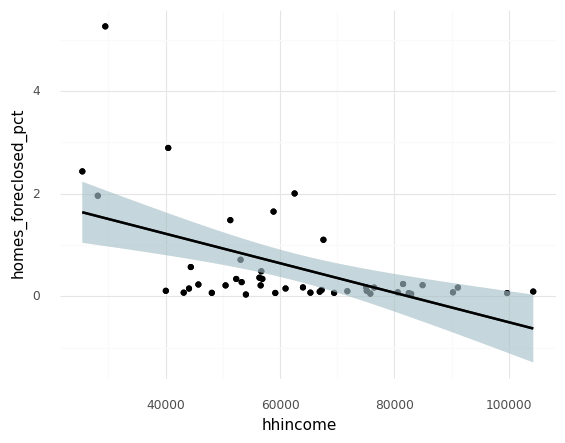

<ggplot: (8747195403192)>

In [ ]:
(
    ggplot(df, aes(x='hhincome', y='homes_foreclosed_pct')) + geom_point()  + geom_point() + geom_smooth(method='lm') + stat_smooth(fill="#ADD8E6", alpha = .4, method="lm") + theme_minimal()
)

Q: Is there a correlation between when houses were built with percentage of foreclosures of owned homes? Not much if at all

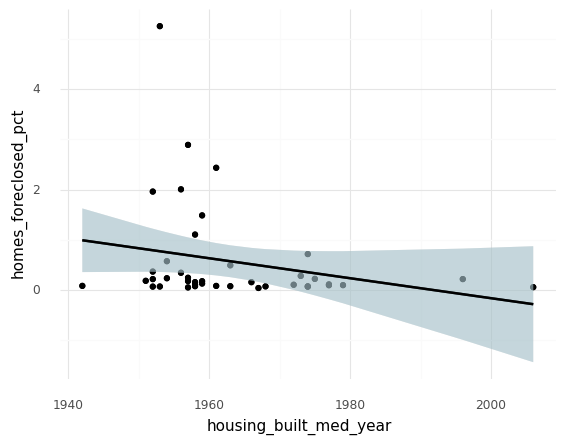

<ggplot: (8747192677166)>

In [ ]:
(
    ggplot(df2, aes(x='housing_built_med_year', y='homes_foreclosed_pct')) + geom_point()  + geom_point() + geom_smooth(method='lm') + stat_smooth(fill="#ADD8E6", alpha = .4, method="lm") + theme_minimal()
)

Q: Is there a correlation between education level (% of 25+ population with bachelor's degree) with percentage of foreclosured homes? Maybe?

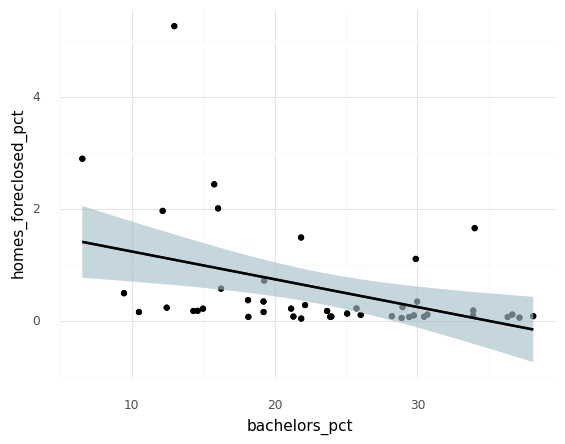

<ggplot: (8747192638642)>

In [ ]:
(
    ggplot(df, aes(x='bachelors_pct', y='homes_foreclosed_pct')) + geom_point()  + geom_point() + geom_smooth(method='lm') + stat_smooth(fill="#ADD8E6", alpha = .4, method="lm") + theme_minimal()
)

Q: Is there a correlation between the gini index in a census tract with percentage of foreclosured homes? slightly

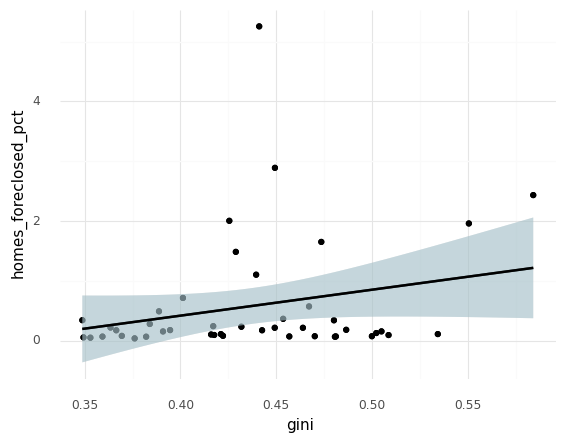

<ggplot: (8747195402873)>

In [ ]:
(
    ggplot(df, aes(x='gini', y='homes_foreclosed_pct')) + geom_point()  + geom_point() + geom_smooth(method='lm') + stat_smooth(fill="#ADD8E6", alpha = .4, method="lm") + theme_minimal()
)

Q: Is there a correlation between the African American/Black population percentage of people in a census tract with percentage of foreclosed homes? Appears to be

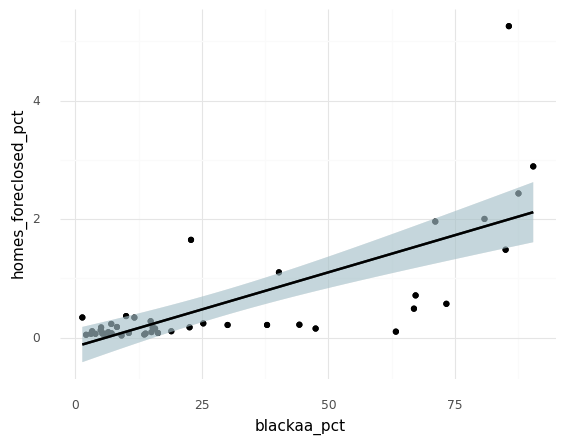

<ggplot: (8747192590213)>

In [ ]:
(
    ggplot(df, aes(x='blackaa_pct', y='homes_foreclosed_pct')) + geom_point()  + geom_point() + geom_smooth(method='lm') + stat_smooth(fill="#ADD8E6", alpha = .4, method="lm") + theme_minimal()
)

Owner occupied homes, how does this differ?

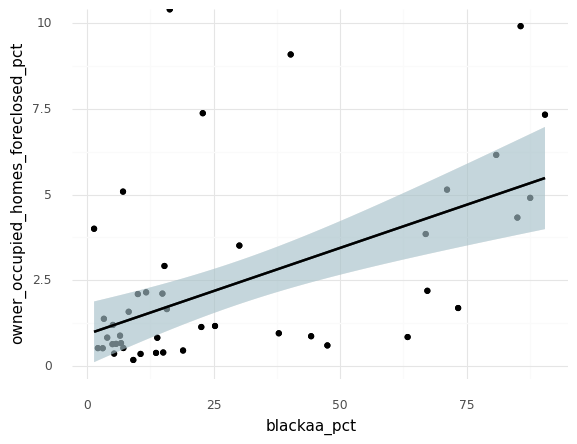

<ggplot: (8747192645536)>

In [ ]:
(
    ggplot(df, aes(x='blackaa_pct', y='owner_occupied_homes_foreclosed_pct')) + geom_point()  + geom_point() + geom_smooth(method='lm') + stat_smooth(fill="#ADD8E6", alpha = .4, method="lm") + theme_minimal()
)

In [ ]:
df.head(5)

,Unnamed: 0,GEOID2,house_count,totPop,hhincome,white,blackaa,aian,asian,nhpi,...,housing_units,occupied_homes,owner_occupied_homes,housing_built_med_year,blackaa_pct,bachelors_pct,gini,owner_occupied_homes_foreclosed_pct,occupied_homes_foreclosed_pct,homes_foreclosed_pct
0,0,12103020105,2,5160.0,104262.0,4301.0,775.0,59.0,122.0,0.0,...,2151.0,2151.0,519.0,1979,15.019380,29.750164,0.4176,0.385356,0.092980,0.092980
1,1,12103020109,14,3204.0,53100.0,1236.0,2154.0,0.0,0.0,0.0,...,1965.0,1965.0,640.0,1974,67.228464,19.270833,0.4013,2.187500,0.712468,0.712468
2,2,12103020110,3,1710.0,56726.0,543.0,1144.0,0.0,12.0,0.0,...,614.0,614.0,78.0,1963,66.900585,9.462916,0.3888,3.846154,0.488599,0.488599
3,3,12103020201,2,4873.0,71765.0,1655.0,3086.0,25.0,55.0,0.0,...,1983.0,1983.0,239.0,1972,63.328545,26.032080,0.4160,0.836820,0.100857,0.100857
4,4,12103020301,3,3453.0,60966.0,1853.0,1639.0,0.0,18.0,0.0,...,1960.0,1960.0,507.0,1958,47.465972,19.233776,0.5049,0.591716,0.153061,0.153061


In [ ]:
df.shape

(44, 23)

In [ ]:
df.columns

Index(['Unnamed: 0', 'GEOID2', 'house_count', 'totPop', 'hhincome', 'white',
       'blackaa', 'aian', 'asian', 'nhpi', 'other', 'pop_twenty_five_up',
       'bachelors', 'housing_units', 'occupied_homes', 'owner_occupied_homes',
       'housing_built_med_year', 'blackaa_pct', 'bachelors_pct', 'gini',
       'owner_occupied_homes_foreclosed_pct', 'occupied_homes_foreclosed_pct',
       'homes_foreclosed_pct'],
      dtype='object')

df_subset does not include the median housing year column because that caused some issues when iterating

In [ ]:
df_subset = df[['GEOID2', 'blackaa_pct', 'homes_foreclosed_pct', 'owner_occupied_homes_foreclosed_pct', 'occupied_homes_foreclosed_pct', 'bachelors_pct', 'hhincome', 'gini']]

In [ ]:
df_subset.head(10)

,GEOID2,blackaa_pct,homes_foreclosed_pct,owner_occupied_homes_foreclosed_pct,occupied_homes_foreclosed_pct,bachelors_pct,hhincome,gini
0,12103020105,15.019380,0.092980,0.385356,0.092980,29.750164,104262.0,0.4176
1,12103020109,67.228464,0.712468,2.187500,0.712468,19.270833,53100.0,0.4013
2,12103020110,66.900585,0.488599,3.846154,0.488599,9.462916,56726.0,0.3888
3,12103020201,63.328545,0.100857,0.836820,0.100857,26.032080,71765.0,0.4160
4,12103020301,47.465972,0.153061,0.591716,0.153061,19.233776,60966.0,0.5049
5,12103020302,44.255112,0.217770,0.860585,0.217770,25.735775,84920.0,0.3635
6,12103020500,71.118531,1.958763,5.142084,1.958763,12.169086,28142.0,0.5505
7,12103020600,80.841387,2.003249,6.156406,2.003249,16.047602,62549.0,0.4255
8,12103020700,85.017991,1.483680,4.325260,1.483680,21.859296,51309.0,0.4289
9,12103020800,90.480185,2.889626,7.331731,2.889626,6.546763,40456.0,0.4493


df_subset2 does include the median housing year column

In [ ]:
df2_subset = df2[['GEOID2', 'blackaa_pct', 'homes_foreclosed_pct', 'owner_occupied_homes_foreclosed_pct', 'occupied_homes_foreclosed_pct', 'housing_built_med_year', 'bachelors_pct', 'hhincome', 'gini']]

In [ ]:
df2_subset.head(10)

,GEOID2,blackaa_pct,homes_foreclosed_pct,owner_occupied_homes_foreclosed_pct,occupied_homes_foreclosed_pct,housing_built_med_year,bachelors_pct,hhincome,gini
0,12103020105,15.019380,0.092980,0.385356,0.092980,1979,29.750164,104262.0,0.4176
1,12103020109,67.228464,0.712468,2.187500,0.712468,1974,19.270833,53100.0,0.4013
2,12103020110,66.900585,0.488599,3.846154,0.488599,1963,9.462916,56726.0,0.3888
3,12103020201,63.328545,0.100857,0.836820,0.100857,1972,26.032080,71765.0,0.4160
4,12103020301,47.465972,0.153061,0.591716,0.153061,1958,19.233776,60966.0,0.5049
5,12103020302,44.255112,0.217770,0.860585,0.217770,1975,25.735775,84920.0,0.3635
6,12103020500,71.118531,1.958763,5.142084,1.958763,1952,12.169086,28142.0,0.5505
7,12103020600,80.841387,2.003249,6.156406,2.003249,1956,16.047602,62549.0,0.4255
8,12103020700,85.017991,1.483680,4.325260,1.483680,1959,21.859296,51309.0,0.4289
9,12103020800,90.480185,2.889626,7.331731,2.889626,1957,6.546763,40456.0,0.4493


Replace nan and infinite values to not cause problems running a regression

> This code is replacing any positive or negative infinite values (np.inf and -np.inf, respectively) in a pandas DataFrame called df_subset with NaN (Not a Number) values. The inplace=True parameter means that the DataFrame is modified in place, without creating a new copy.

> This operation is often performed to deal with missing or invalid data, as infinite values can cause problems with mathematical operations and analysis. By replacing them with NaN, they can be easily identified and handled in subsequent data processing steps.

> In this dataset, as a number of the columns are percentages, there were some infinite values because of 0/X etc.


In [ ]:
df_subset.replace([np.inf, -np.inf], np.nan, inplace=True)

<ipython-input-259-53bcf43a4ae1>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [ ]:
df.shape

(44, 23)

In [ ]:
df_subset.shape

(44, 8)

In [ ]:
df2_subset.replace([np.inf, -np.inf], np.nan, inplace=True)

<ipython-input-262-ac854243ee69>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [ ]:
df2.shape

(41, 23)

In [ ]:
df2_subset.shape

(41, 9)

### Regressions

In [ ]:
# homes_foreclosed_pct
# blackaa_pct --> homes foreclosed Percentage?
import statsmodels.formula.api as smf

model = smf.ols("homes_foreclosed_pct ~ blackaa_pct", data=df_subset)
results = model.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                             OLS Regression Results                             
================================================================================
Dep. Variable:     homes_foreclosed_pct   R-squared:                       0.521
Model:                              OLS   Adj. R-squared:                  0.510
Method:                   Least Squares   F-statistic:                     45.70
Date:                  Mon, 03 Apr 2023   Prob (F-statistic):           3.21e-08
Time:                          19:33:28   Log-Likelihood:                -45.882
No. Observations:                    44   AIC:                             95.76
Df Residuals:                        42   BIC:                             99.33
Df Model:                             1                                         
Covariance Type:              nonrobust                                         
===============================================================================
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
Intercept      -0.1507      0.151     -0.998      0.324      -0.455       0.154
blackaa_pct     0.0251      0.004      6.760      0.000       0.018       0.033
==============================================================================
Omnibus:                       41.212   Durbin-Watson:                   1.592
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              202.398
Skew:                           2.126   Prob(JB):                     1.12e-44
Kurtosis:                      12.608   Cond. No.                         58.1
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

##### **Initial Observations**
In this case, the R-squared value of 0.521 indicates that approximately 52.1% of the variability in the percentage of homes foreclosed can be explained by the percentage of the population that is African American or Black included in the model. The adjusted R-squared value of 0.510 takes into account the number of independent variables in the model and suggests that the percentage of the population that is African American or Black may explain slightly less of the variability in the percentage of homes foreclosed than the R-squared value suggests.

Overall, the results suggest that there may be a moderate to a good relationship between the percentage of the population that is African American or Black and the percentage of homes foreclosed. However, it is important to note that correlation does not necessarily imply causation, and there may be other factors that contribute to the percentage of homes foreclosed that are not captured in the model. It is also important to evaluate the statistical significance of the independent variable and assess the assumptions of the regression to ensure that the model is a valid representation of the relationship between the variables.


**Simplified**

These results suggest that there may be a relationship between the percentage of African American or Black people in a community and the percentage of homes that have been foreclosed. About 52% of the differences in the percentage of foreclosed homes can be explained by the percentage of African American or Black people in the area. However, it's important to remember that there could be other factors that contribute to the percentage of foreclosed homes that we didn't look at in this study. Additionally, we need to make sure that our statistical analysis is valid and reliable.

In [ ]:
# blackaa_pct --> Owner occupied homes foreclosed Percentage? there's less of a relationship
import statsmodels.formula.api as smf

model = smf.ols("owner_occupied_homes_foreclosed_pct ~ blackaa_pct", data=df_subset)
results = model.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                     OLS Regression Results                                    
===============================================================================================
Dep. Variable:     owner_occupied_homes_foreclosed_pct   R-squared:                       0.342
Model:                                             OLS   Adj. R-squared:                  0.325
Method:                                  Least Squares   F-statistic:                     21.26
Date:                                 Mon, 03 Apr 2023   Prob (F-statistic):           3.88e-05
Time:                                         19:33:28   Log-Likelihood:                -91.203
No. Observations:                                   43   AIC:                             186.4
Df Residuals:                                       41   BIC:                             189.9
Df Model:                                            1                                         
Covariance Type:                             nonrobust                                         
===============================================================================
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
Intercept       0.9212      0.449      2.050      0.047       0.014       1.829
blackaa_pct     0.0504      0.011      4.611      0.000       0.028       0.072
==============================================================================
Omnibus:                       15.086   Durbin-Watson:                   1.671
Prob(Omnibus):                  0.001   Jarque-Bera (JB):               16.769
Skew:                           1.284   Prob(JB):                     0.000228
Kurtosis:                       4.664   Cond. No.                         58.7
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

**Observation: There is a stronger relationship between percentage of the population who is black/african-american and that of the percentage of all homes foreclosed as opposed to owned homes.**

In [ ]:
# hhincome --> homes foreclosed Percentage? r-squared 0.278, adj. r-squared = 0.26
import statsmodels.formula.api as smf

model = smf.ols("homes_foreclosed_pct ~ hhincome", data=df_subset)
results = model.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                             OLS Regression Results                             
================================================================================
Dep. Variable:     homes_foreclosed_pct   R-squared:                       0.278
Model:                              OLS   Adj. R-squared:                  0.260
Method:                   Least Squares   F-statistic:                     16.13
Date:                  Mon, 03 Apr 2023   Prob (F-statistic):           0.000239
Time:                          19:33:28   Log-Likelihood:                -54.927
No. Observations:                    44   AIC:                             113.9
Df Residuals:                        42   BIC:                             117.4
Df Model:                             1                                         
Covariance Type:              nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      2.3678      0.465      5.098      0.000       1.430       3.305
hhincome   -2.872e-05   7.15e-06     -4.017      0.000   -4.31e-05   -1.43e-05
==============================================================================
Omnibus:                       36.737   Durbin-Watson:                   1.472
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              113.921
Skew:                           2.108   Prob(JB):                     1.83e-25
Kurtosis:                       9.660   Cond. No.                     2.32e+05
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 2.32e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

**Observation: There is a small relationship between income and homes foreclosed.**

How about when they are combined?

In [ ]:
# Multiple factors --> Owner occupied homes foreclosed Percentage? r-squared = 0.559, adj. r-squared = 0.537
import statsmodels.formula.api as smf

model = smf.ols("homes_foreclosed_pct ~ blackaa_pct + hhincome", data=df_subset)
results = model.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                             OLS Regression Results                             
================================================================================
Dep. Variable:     homes_foreclosed_pct   R-squared:                       0.559
Model:                              OLS   Adj. R-squared:                  0.537
Method:                   Least Squares   F-statistic:                     25.95
Date:                  Mon, 03 Apr 2023   Prob (F-statistic):           5.21e-08
Time:                          19:33:28   Log-Likelihood:                -44.082
No. Observations:                    44   AIC:                             94.16
Df Residuals:                        41   BIC:                             99.52
Df Model:                             2                                         
Covariance Type:              nonrobust                                         
===============================================================================
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
Intercept       0.7208      0.489      1.475      0.148      -0.266       1.708
blackaa_pct     0.0212      0.004      5.111      0.000       0.013       0.030
hhincome    -1.218e-05   6.52e-06     -1.870      0.069   -2.53e-05    9.78e-07
==============================================================================
Omnibus:                       39.232   Durbin-Watson:                   1.714
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              170.938
Skew:                           2.058   Prob(JB):                     7.61e-38
Kurtosis:                      11.735   Cond. No.                     3.09e+05
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 3.09e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [ ]:
# Multiple factors --> Owner occupied homes foreclosed Percentage? r-squared = 0.559, adj. r-squared = 0.537
import statsmodels.formula.api as smf

model = smf.ols("homes_foreclosed_pct ~ blackaa_pct + hhincome + blackaa_pct:hhincome", data=df_subset)
results = model.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                             OLS Regression Results                             
================================================================================
Dep. Variable:     homes_foreclosed_pct   R-squared:                       0.701
Model:                              OLS   Adj. R-squared:                  0.679
Method:                   Least Squares   F-statistic:                     31.29
Date:                  Mon, 03 Apr 2023   Prob (F-statistic):           1.40e-10
Time:                          20:40:32   Log-Likelihood:                -35.504
No. Observations:                    44   AIC:                             79.01
Df Residuals:                        40   BIC:                             86.14
Df Model:                             3                                         
Covariance Type:              nonrobust                                         
========================================================================================
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
Intercept               -0.5243      0.497     -1.055      0.298      -1.529       0.480
blackaa_pct              0.0615      0.010      6.244      0.000       0.042       0.081
hhincome              8.645e-06   7.23e-06      1.196      0.239   -5.96e-06    2.32e-05
blackaa_pct:hhincome -7.873e-07    1.8e-07     -4.367      0.000   -1.15e-06   -4.23e-07
==============================================================================
Omnibus:                       29.712   Durbin-Watson:                   1.984
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               80.862
Skew:                           1.672   Prob(JB):                     2.76e-18
Kurtosis:                       8.737   Cond. No.                     1.20e+07
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.2e+07. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [ ]:
# Multiple factors --> Owner occupied homes foreclosed Percentage? r-squared = 0.559, adj. r-squared = 0.537
import statsmodels.formula.api as smf

model = smf.ols("homes_foreclosed_pct ~ blackaa_pct + hhincome", data=df_subset)
results = model.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                             OLS Regression Results                             
================================================================================
Dep. Variable:     homes_foreclosed_pct   R-squared:                       0.559
Model:                              OLS   Adj. R-squared:                  0.537
Method:                   Least Squares   F-statistic:                     25.95
Date:                  Mon, 03 Apr 2023   Prob (F-statistic):           5.21e-08
Time:                          20:40:55   Log-Likelihood:                -44.082
No. Observations:                    44   AIC:                             94.16
Df Residuals:                        41   BIC:                             99.52
Df Model:                             2                                         
Covariance Type:              nonrobust                                         
===============================================================================
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
Intercept       0.7208      0.489      1.475      0.148      -0.266       1.708
blackaa_pct     0.0212      0.004      5.111      0.000       0.013       0.030
hhincome    -1.218e-05   6.52e-06     -1.870      0.069   -2.53e-05    9.78e-07
==============================================================================
Omnibus:                       39.232   Durbin-Watson:                   1.714
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              170.938
Skew:                           2.058   Prob(JB):                     7.61e-38
Kurtosis:                      11.735   Cond. No.                     3.09e+05
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 3.09e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [ ]:
# Multiple factors --> Owner occupied homes foreclosed Percentage? r-squared = 0.559, adj. r-squared = 0.537
import statsmodels.formula.api as smf

model = smf.ols("homes_foreclosed_pct ~ blackaa_pct**2 + hhincome", data=df_subset)
results = model.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                             OLS Regression Results                             
================================================================================
Dep. Variable:     homes_foreclosed_pct   R-squared:                       0.559
Model:                              OLS   Adj. R-squared:                  0.537
Method:                   Least Squares   F-statistic:                     25.95
Date:                  Mon, 03 Apr 2023   Prob (F-statistic):           5.21e-08
Time:                          20:40:46   Log-Likelihood:                -44.082
No. Observations:                    44   AIC:                             94.16
Df Residuals:                        41   BIC:                             99.52
Df Model:                             2                                         
Covariance Type:              nonrobust                                         
===============================================================================
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
Intercept       0.7208      0.489      1.475      0.148      -0.266       1.708
blackaa_pct     0.0212      0.004      5.111      0.000       0.013       0.030
hhincome    -1.218e-05   6.52e-06     -1.870      0.069   -2.53e-05    9.78e-07
==============================================================================
Omnibus:                       39.232   Durbin-Watson:                   1.714
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              170.938
Skew:                           2.058   Prob(JB):                     7.61e-38
Kurtosis:                      11.735   Cond. No.                     3.09e+05
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 3.09e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In this case, the R-squared value of 0.559 indicates that approximately 55.9% of the variability in the percentage of homes foreclosed can be explained by the percentage of the population that is African American or Black and the median household incom included in the model.

In [ ]:
# Multiple factors --> Owner occupied homes foreclosed Percentage? r-squared = 0.560, adj. r-squared = 0.515
import statsmodels.formula.api as smf

model = smf.ols("homes_foreclosed_pct ~ blackaa_pct + hhincome + gini + bachelors_pct", data=df_subset)
results = model.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                             OLS Regression Results                             
================================================================================
Dep. Variable:     homes_foreclosed_pct   R-squared:                       0.560
Model:                              OLS   Adj. R-squared:                  0.515
Method:                   Least Squares   F-statistic:                     12.41
Date:                  Mon, 03 Apr 2023   Prob (F-statistic):           1.32e-06
Time:                          19:33:28   Log-Likelihood:                -44.012
No. Observations:                    44   AIC:                             98.02
Df Residuals:                        39   BIC:                             106.9
Df Model:                             4                                         
Covariance Type:              nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
Intercept         0.5803      1.203      0.482      0.632      -1.853       3.014
blackaa_pct       0.0217      0.005      4.774      0.000       0.013       0.031
hhincome      -1.298e-05   8.34e-06     -1.557      0.128   -2.98e-05    3.88e-06
gini              0.1170      2.238      0.052      0.959      -4.410       4.644
bachelors_pct     0.0054      0.018      0.306      0.761      -0.030       0.041
==============================================================================
Omnibus:                       39.280   Durbin-Watson:                   1.707
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              172.442
Skew:                           2.056   Prob(JB):                     3.59e-38
Kurtosis:                      11.783   Cond. No.                     1.54e+06
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.54e+06. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [ ]:
# bacherlors_pct --> homes_foreclosed_pct? r-squared = 0.168, adj. r-squared = 0.148
import statsmodels.formula.api as smf

model = smf.ols("homes_foreclosed_pct ~ bachelors_pct", data=df_subset)
results = model.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                             OLS Regression Results                             
================================================================================
Dep. Variable:     homes_foreclosed_pct   R-squared:                       0.168
Model:                              OLS   Adj. R-squared:                  0.148
Method:                   Least Squares   F-statistic:                     8.478
Date:                  Mon, 03 Apr 2023   Prob (F-statistic):            0.00573
Time:                          19:33:28   Log-Likelihood:                -58.034
No. Observations:                    44   AIC:                             120.1
Df Residuals:                        42   BIC:                             123.6
Df Model:                             1                                         
Covariance Type:              nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
Intercept         1.7295      0.420      4.120      0.000       0.882       2.577
bachelors_pct    -0.0496      0.017     -2.912      0.006      -0.084      -0.015
==============================================================================
Omnibus:                       43.205   Durbin-Watson:                   1.220
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              163.894
Skew:                           2.466   Prob(JB):                     2.58e-36
Kurtosis:                      11.066   Cond. No.                         74.3
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [ ]:
# housing_built_med_year --> occupied homes foreclosed Percentage? r-squared 0.058, adj. r-squared 0.034
import statsmodels.formula.api as smf

model = smf.ols("occupied_homes_foreclosed_pct ~ housing_built_med_year", data=df2)
results = model.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                  OLS Regression Results                                 
=========================================================================================
Dep. Variable:     occupied_homes_foreclosed_pct   R-squared:                       0.058
Model:                                       OLS   Adj. R-squared:                  0.034
Method:                            Least Squares   F-statistic:                     2.411
Date:                           Mon, 03 Apr 2023   Prob (F-statistic):              0.129
Time:                                   19:33:28   Log-Likelihood:                -57.401
No. Observations:                             41   AIC:                             118.8
Df Residuals:                                 39   BIC:                             122.2
Df Model:                                      1                                         
Covariance Type:                       nonrobust                                         
==========================================================================================
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
Intercept                 39.6653     25.183      1.575      0.123     -11.273      90.604
housing_built_med_year    -0.0199      0.013     -1.553      0.129      -0.046       0.006
==============================================================================
Omnibus:                       46.100   Durbin-Watson:                   0.844
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              184.492
Skew:                           2.778   Prob(JB):                     8.67e-41
Kurtosis:                      11.782   Cond. No.                     3.15e+05
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 3.15e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [ ]:
# gini --> homes_foreclosed_pct? r-squared = 0.060, adj. r-squared = 0.038
import statsmodels.formula.api as smf

model = smf.ols("homes_foreclosed_pct ~ gini", data=df_subset)
results = model.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                             OLS Regression Results                             
================================================================================
Dep. Variable:     homes_foreclosed_pct   R-squared:                       0.060
Model:                              OLS   Adj. R-squared:                  0.038
Method:                   Least Squares   F-statistic:                     2.678
Date:                  Mon, 03 Apr 2023   Prob (F-statistic):              0.109
Time:                          19:33:28   Log-Likelihood:                -60.719
No. Observations:                    44   AIC:                             125.4
Df Residuals:                        42   BIC:                             129.0
Df Model:                             1                                         
Covariance Type:              nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     -1.3209      1.169     -1.130      0.265      -3.680       1.038
gini           4.3427      2.654      1.636      0.109      -1.013       9.698
==============================================================================
Omnibus:                       52.044   Durbin-Watson:                   1.131
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              268.736
Skew:                           2.956   Prob(JB):                     4.41e-59
Kurtosis:                      13.565   Cond. No.                         21.3
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

## Final result for the scrollytelling map and text in story

"The foreclosures have brought in millions for the cities, but have taken away homes that have been in families for generations, particularly in heavily Black and lower income neighborhoods. And the lawyer who has aggressively pursued the practice is trying to make cities in South Florida next."

"The lawsuits have been filed predominantly in heavily Black neighborhoods, which property owners see as part of a mission to gentrify and redevelop their neighborhoods by pushing them out."


"But in both Clearwater and St. Petersburg, the areas where Weidner has filed the most foreclosure lawsuits are also the areas with the highest share of Black residents, the Herald’s analysis found."

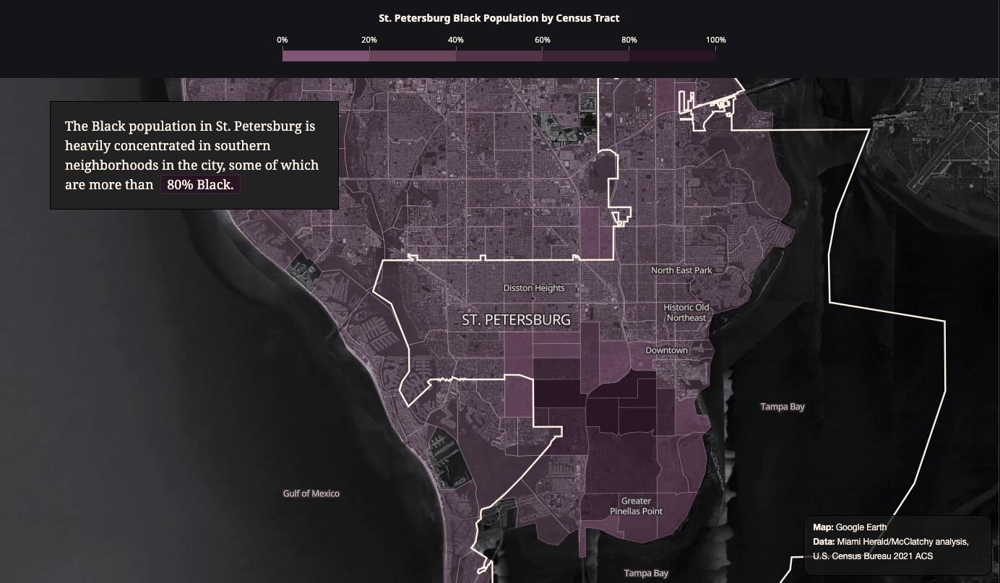

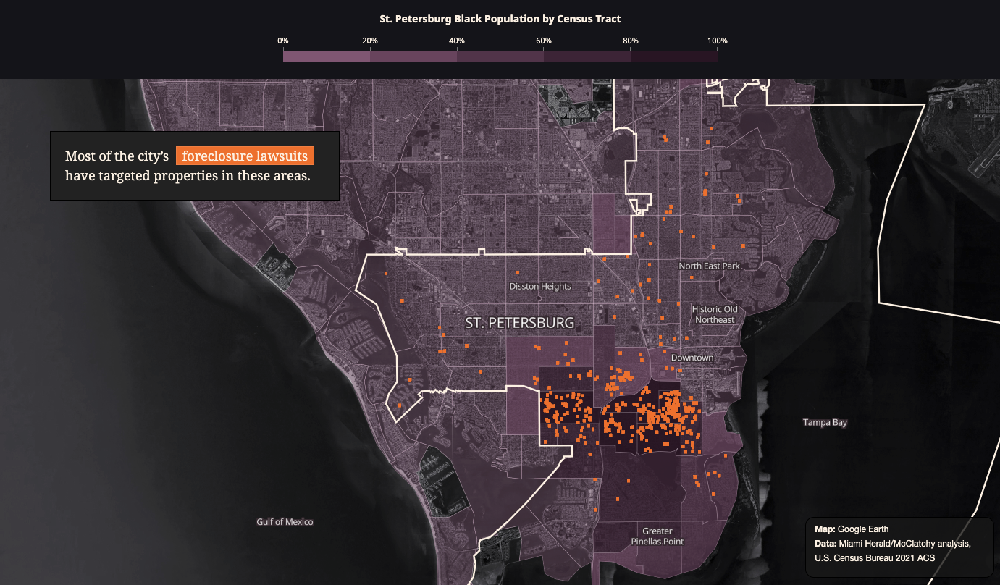

"Former St. Petersburg Mayor Rick Kriseman, whose administration introduced the foreclosure program, had no explanation for why the preponderance of foreclosures were in heavily Black areas. “I don’t know why that would be,” he said. 'But there certainly wasn’t any target.'"

"The loss of homes that would be passed down from one generation of Black families to the next is significant, because the share of Black families that inherit wealth is half the share of white families that do, according to research by economists at the Federal Reserve Board."

"And the average inheritance received by white families is nearly three times the average inheritance received by Black families."

"In lower-income Black neighborhoods, such as the Clearwater neighborhood that Clark’s house is located in, property title issues have a major intergenerational impact, Wright, the University of Florida professor, said."

"'The amount of wealth that has been lost in these low-income communities is phenomenal,' she said."

"Malekia and Maya McKinney grew up in a predominantly Black neighborhood in St. Petersburg that has been one of the biggest targets of the city’s code enforcement lawsuits. Since 2015, there have been 107 lawsuits filed against properties in the same Zip code, and roughly two-thirds of those cases resulted in foreclosures."

----